# Used Car Prices CarGurus lightGBM GPU
# Weights & Biases Optuna Hyperparameter Optimization

## Set Up Environment, Read Data, Prepare for Modeling

In [ ]:
# In terminal
sudo apt update && sudo apt upgrade

sudo apt-get -y install cmake

sudo apt-get install -y -qq libboost-all-dev libboost-system-dev libboost-filesystem-dev

sudo apt-get install --no-install-recommends nvidia-opencl-dev opencl-headers

sudo apt install glibc-source -y

In [ ]:
%cd /notebooks

In [ ]:
# Clone repo
!git clone --recursive https://github.com/microsoft/LightGBM

Cloning into 'LightGBM'...
remote: Enumerating objects: 28765, done.
remote: Counting objects: 100% (3846/3846), done.
remote: Compressing objects: 100% (451/451), done.
remote: Total 28765 (delta 3575), reused 3485 (delta 3386), pack-reused 24919
Receiving objects: 100% (28765/28765), 20.18 MiB | 2.37 MiB/s, done.
Resolving deltas: 100% (21307/21307), done.
Updating files: 100% (535/535), done.
Submodule 'include/boost/compute' (https://github.com/boostorg/compute) registered for path 'external_libs/compute'
Submodule 'eigen' (https://gitlab.com/libeigen/eigen.git) registered for path 'external_libs/eigen'
Submodule 'external_libs/fast_double_parser' (https://github.com/lemire/fast_double_parser.git) registered for path 'external_libs/fast_double_parser'
Submodule 'external_libs/fmt' (https://github.com/fmtlib/fmt.git) registered for path 'external_libs/fmt'
Cloning into '/notebooks/LightGBM/external_libs/compute'...
remote: Enumerating objects: 21733, done.        
remote: Counting o

In [ ]:
# Set up build
%cd /notebooks/LightGBM

!sudo mkdir build

!sudo mkdir -p /etc/OpenCL/vendors && echo "libnvidia-opencl.so.1" > /etc/OpenCL/vendors/nvidia.icd

/notebooks/LightGBM


In [ ]:
%cd /notebooks/LightGBM/build

/notebooks/LightGBM/build


In [ ]:
# Use cmake to build
!sudo cmake -DUSE_GPU=1 -DOpenCL_LIBRARY=/usr/local/cuda/lib64/libOpenCL.so -DOpenCL_INCLUDE_DIR=/usr/local/cuda/include/ ..

-- OpenCL include directory: /usr/local/cuda/include
-- Using _mm_prefetch
-- Using _mm_malloc
-- Configuring done
-- Generating done
-- Build files have been written to: /notebooks/LightGBM/build


In [ ]:
# Build
!make -j4

[  1%] Built target lightgbm_capi_objs
[ 92%] Built target lightgbm_objs
[ 94%] Built target _lightgbm
[100%] Built target lightgbm


In [ ]:
# Install dependencies
!sudo apt-get -y install python3-pip
!sudo -H pip install setuptools joblib wandb optuna datetime plotly eli5 shap -U

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  python-pip-whl python3-setuptools python3-wheel
Suggested packages:
  python-setuptools-doc
The following NEW packages will be installed:
  python-pip-whl python3-pip python3-setuptools python3-wheel
0 upgraded, 4 newly installed, 0 to remove and 0 not upgraded.
Need to get 2389 kB of archives.
After this operation, 4932 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python-pip-whl all 20.0.2-5ubuntu1.6 [1805 kB]
Get:2 http://archive.ubuntu.com/ubuntu focal/main amd64 python3-setuptools all 45.2.0-1 [330 kB]
Get:3 http://archive.ubuntu.com/ubuntu focal/universe amd64 python3-wheel all 0.34.2-1 [23.8 kB]
Get:4 http://archive.ubuntu.com/ubuntu focal-updates/universe amd64 python3-pip all 20.0.2-5ubuntu1.6 [231 kB]
Fetched 2389 kB in 1s (2944 kB/s)   
Selecting previously unsele

In [ ]:
# Install LightGBM GPU
%cd /notebooks/LightGBM/python-package/
!python setup.py install --gpu --opencl-include-dir=/usr/local/cuda/include/

/notebooks/LightGBM/python-package
INFO:root:running install
/usr/local/lib/python3.9/dist-packages/setuptools/command/install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(
INFO:LightGBM:Starting to compile the library.
INFO:LightGBM:Starting to compile with CMake.
INFO:root:running build
INFO:root:running build_py
INFO:root:running egg_info
INFO:root:writing lightgbm.egg-info/PKG-INFO
INFO:root:writing dependency_links to lightgbm.egg-info/dependency_links.txt
INFO:root:writing requirements to lightgbm.egg-info/requires.txt
INFO:root:writing top-level names to lightgbm.egg-info/top_level.txt
INFO:root:reading manifest file 'lightgbm.egg-info/SOURCES.txt'
INFO:root:reading manifest template 'MANIFEST.in'
INFO:root:adding license file 'LICENSE'
INFO:root:writing manifest file 'lightgbm.egg-info/SOURCES.txt'
INFO:root:copying lightgbm/VERSION.txt -> build/lib/lightgbm
INFO:root:running install_lib


# Quadro RTX 4000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
import shap
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_lgbmGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sun Jan 22 21:17:19 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 4000     Off  | 00000000:00:05.0 Off |                  N/A |
| 30%   28C    P8     4W / 125W |      3MiB /  8192MiB |      0%      Default |
|                               |    

In [ ]:
%cd /notebooks/UsedCarsCarGurus/Data/

/notebooks/UsedCarsCarGurus/Data


In [ ]:
# Read data
trainDF = pd.read_csv('usedCars_trainSet.csv', low_memory=False)
testDF = pd.read_csv('usedCars_testSet.csv', low_memory=False)

# Define label and features
train_label = trainDF[['price']]
test_label = testDF[['price']]
train_features = trainDF.drop(columns = ['price'])
test_features = testDF.drop(columns = ['price'])

# Create dummy variables for categorical variables
train_features = pd.get_dummies(train_features, drop_first=True)
test_features = pd.get_dummies(test_features, drop_first=True)

# Extract feature names
features = train_features.columns
features = np.array(features)

## 100 Trials 5-Fold Cross Validation 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_RTX4000_cv_nfold5', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_RTX4000_cv_nfold5'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_RTX4000_wb_5CV.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Create a lgb dataset 
    train_set = lgb.Dataset(train_features, label=train_label, params=params)

    # Start timer for each trial
    start = timer()
      
    # Train the model
    # Perform k_folds cross validation to find lower error
    cv_results = lgb.cv(params, train_set, nfold=5, stratified=False)
    run_time = timer() - start

    # Extract best score
    rmse = round(cv_results['valid rmse-mean'][-1], 4)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX4000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX4000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-22 01:54:24.483740


- Trial RMSE: 2767.0443


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2723.5883


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2700.046


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2753.0023


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2721.8018


wandb: Network error (ReadTimeout), entering retry loop.


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2714.3603


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2693.4352


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2756.6617


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.9279


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2717.9122


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.4964


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.1325


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.6383


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2690.34


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3946


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.0671


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2711.4697


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.294


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2708.8573


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2691.1972


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.8743


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.1081


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.4942


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4698


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.5053


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.301


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8877


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.6468


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.0423


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2741.5873


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.8234


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3295


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.0997


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7828


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.445


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.9458


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.9961


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.9569


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.9965


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.7748


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2745.4288


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8354


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.9484


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.9824


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.8087


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3405


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8619


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8916


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.6448


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.2045


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.1291


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.7655


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.5022


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.9939


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.6153


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.7921


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.4775


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9875


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.625


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.42


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.4315


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8817


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.5685


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.505


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8145


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7423


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.8765


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.9251


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.0175


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.1292


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.5936


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2113


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.0657


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.9449


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8545


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8547


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.9536


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.0648


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2739.7763


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.5516


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.0085


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4869


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.0745


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.821


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.4588


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7365


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4979


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.372


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3616


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2882


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3058


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.3173


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


In [ ]:
# Load to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_RTX4000_wb_5CV.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 93
Best trial: {'n_estimators': 930, 'learning_rate': 0.007998884894321845, 'num_leaves': 365, 'bagging_freq': 9, 'subsample': 0.9496799267839345, 'colsample_bytree': 0.7875606291431052, 'max_depth': 11, 'lambda_l1': 0.023695664906620815, 'lambda_l2': 0.001246554136855555, 'min_child_samples': 541}
Lowest RMSE 2683.7423


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX4000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX4000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=8, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-22 21:49:44.194172


- Trial RMSE: 2684.4991


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2894


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7554


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9879


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.1069


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.1644


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2707.752


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8245


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-22 21:49:44.194172
End Time             2023-01-22 22:21:09.962467
0:31:25


Number of finished trials: 101
Best trial: {'n_estimators': 930, 'learning_rate': 0.007998884894321845, 'num_leaves': 365, 'bagging_freq': 9, 'subsample': 0.9496799267839345, 'colsample_bytree': 0.7875606291431052, 'max_depth': 11, 'lambda_l1': 0.023695664906620815, 'lambda_l2': 0.001246554136855555, 'min_child_samples': 541}
Lowest RMSE 2683.7423


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_RTX4000_wb_CV.csv', index=False)
print(trials_df) 

    iteration       rmse             datetime_start  \
65         65  2683.7423 2023-01-22 05:47:55.772323   
76         76  2683.9536 2023-01-22 06:27:44.172034   
71         71  2684.2113 2023-01-22 06:09:47.536698   
89         89  2684.2882 2023-01-22 07:11:01.871768   
91         91  2684.3173 2023-01-22 07:17:58.614501   
..        ...        ...                        ...   
40         40  2745.4288 2023-01-22 04:14:55.201236   
3           3  2753.0023 2023-01-22 02:02:35.457364   
7           7  2756.6617 2023-01-22 02:17:12.434316   
0           0  2767.0443 2023-01-22 01:54:24.485650   
92         92        NaN 2023-01-22 07:21:26.031933   

            datetime_complete               duration  bagging_freq  \
65 2023-01-22 05:51:30.826584 0 days 00:03:35.054261           9.0   
76 2023-01-22 06:31:39.784617 0 days 00:03:55.612583           9.0   
71 2023-01-22 06:12:58.993169 0 days 00:03:11.456471           9.0   
89 2023-01-22 07:14:08.753148 0 days 00:03:06.881380       

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_RTX4000_wb_CV.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_RTX4000_wb_CV.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_RTX4000_wb_CV.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_RTX4000_wb_CV.html')
fig.show()

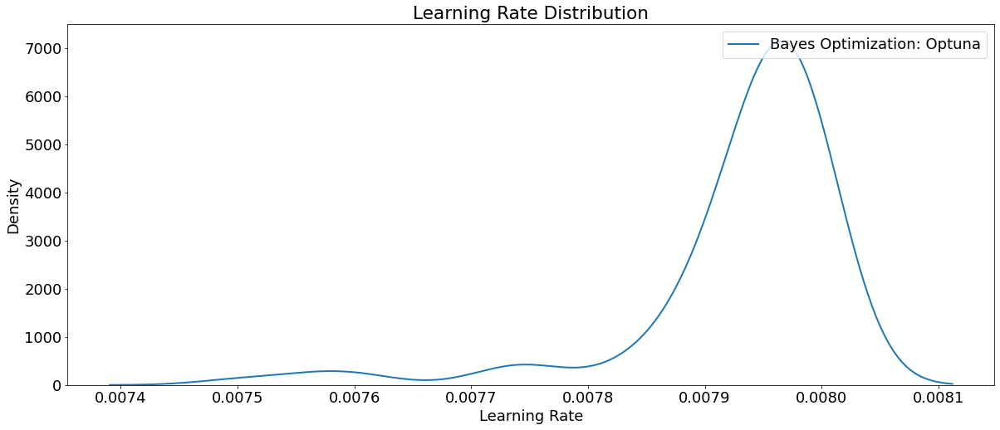

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

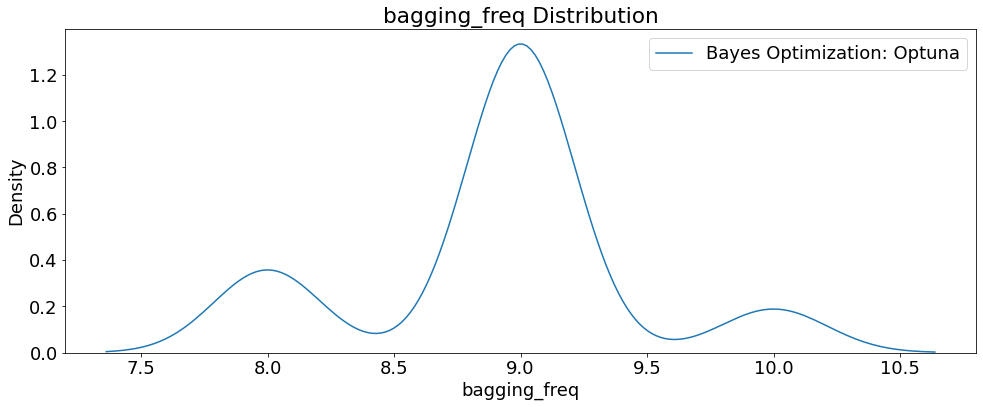

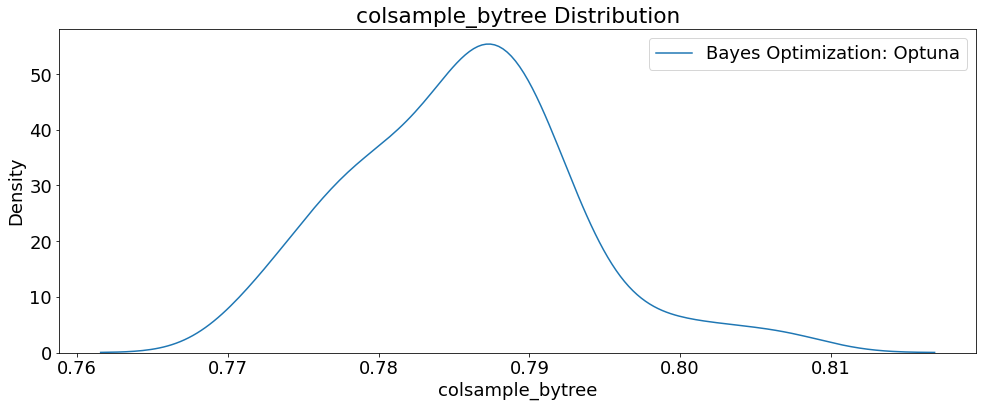

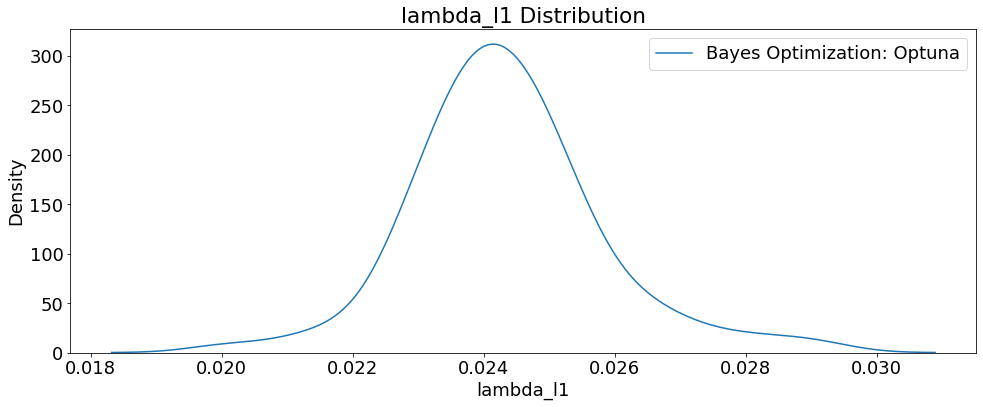

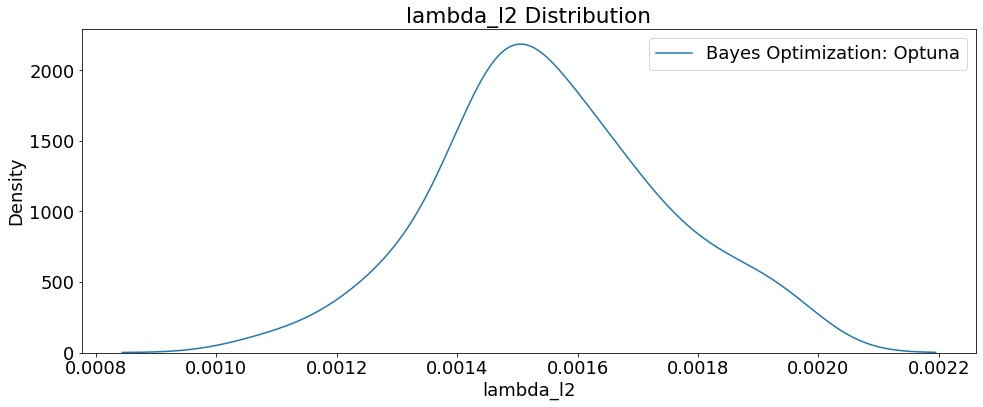

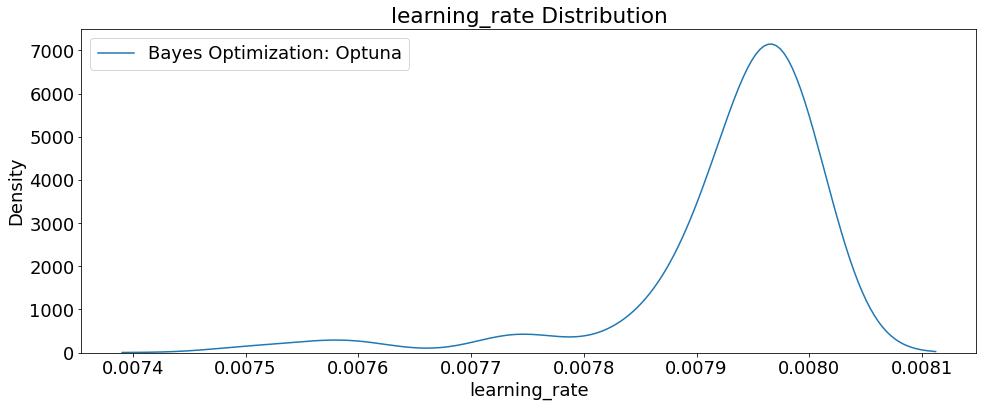

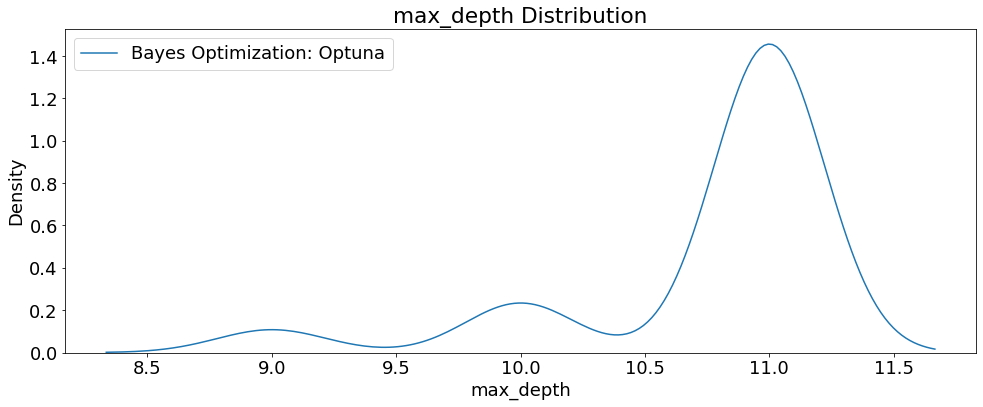

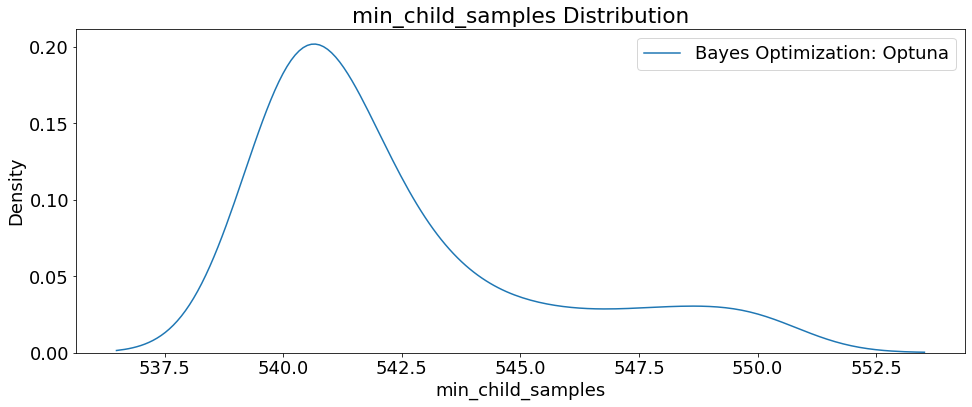

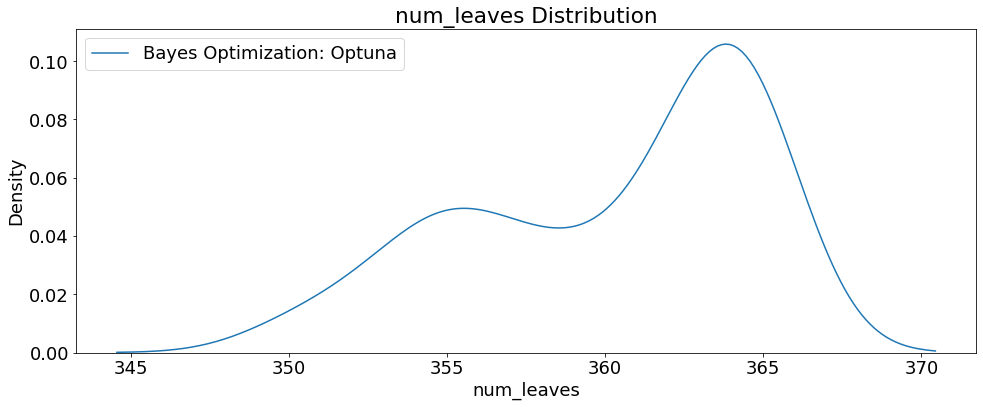

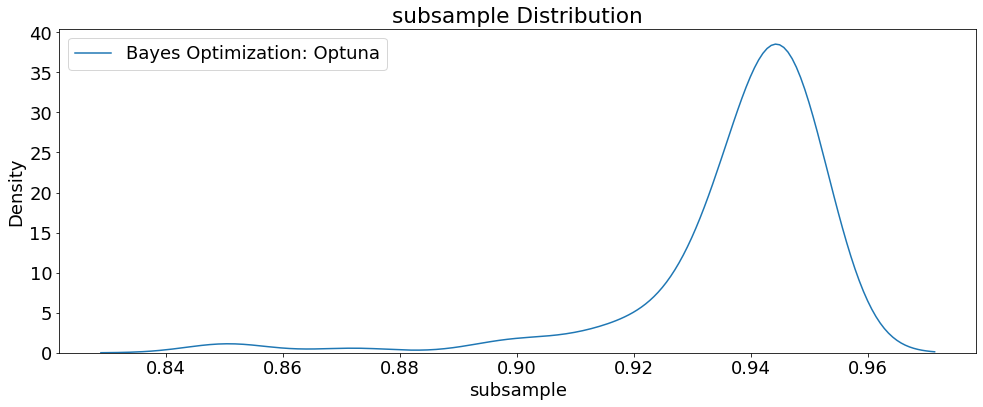

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

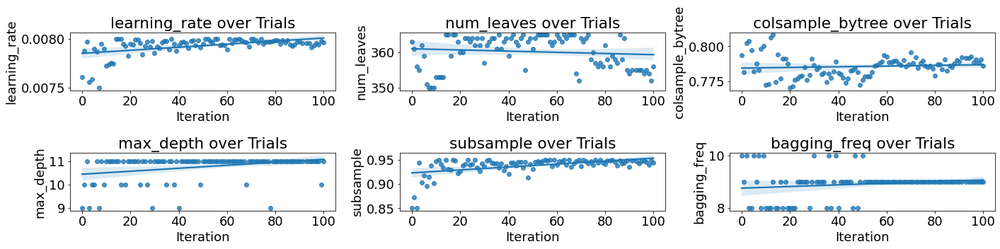

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

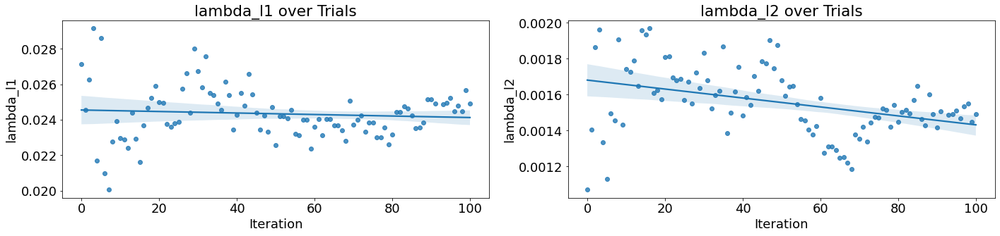

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_RTX4000_wb_CV.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_RTX4000_wb_CV.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 930,
 'learning_rate': 0.007998884894321845,
 'num_leaves': 365,
 'bagging_freq': 9,
 'subsample': 0.9496799267839345,
 'colsample_bytree': 0.7875606291431052,
 'max_depth': 11,
 'lambda_l1': 0.023695664906620815,
 'lambda_l2': 0.001246554136855555,
 'min_child_samples': 541,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_RTX4000_wb_CV.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_RTX4000_wb_CV.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.835, test: 1969.537
MSE train: 6817743.251, test: 6979899.719
RMSE train: 2611.081, test: 2641.950
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6979899.71890 MSE on the test set.
This was achieved using these conditions:
iteration                                    65
rmse                                  2683.7423
datetime_start       2023-01-22 05:47:55.772323
datetime_complete    2023-01-22 05:51:30.826584
duration                 0 days 00:03:35.054261
bagging_freq                                9.0
colsample_bytree                       0.787561
lambda_l1                              0.023696
lambda_l2                              0.001247
learning_rate                          0.007999
max_depth                                  11.0
min_child_samples                         541.0
n_estimators                              930.0
num_leaves                                365.0
subsample                               0.94968
state                                  COMPLETE
Name: 65, dtype: object


## 100 Trials Train/Validation/Test 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_RTX4000_trainValTest_kfold10', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_RTX4000_trainValTest_kfold10'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_RTX4000_wb_trainValSplit.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Set same k-folds for reproducibility
    kf = KFold(n_splits=10, shuffle=True, random_state=seed_value)

    # Create train and validation sets
    for trn_idx, val_idx in kf.split(trainDF[features], train_label): 
        train_Features, train_Label = trainDF[features].iloc[trn_idx], train_label.iloc[trn_idx]
        val_Features, val_Label = trainDF[features].iloc[val_idx], train_label.iloc[val_idx] 

      # Define model
      model = LGBMRegressor(**params)

      # Start timer for each trial
      start = timer()
      
      # Train the model
      model.fit(train_Features, train_Label, 
                eval_set = [(val_Features, val_Label), 
                            (train_Features, train_Label)]) 
      run_time = timer() - start

      # Predictions
      y_pred_val = model.predict(val_Features)
      rmse = mean_squared_error(val_Label, y_pred_val, squared=False)
      
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX4000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX4000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-21 16:42:59.507176


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-21 16:42:59.507176
End Time             2023-01-21 17:54:17.481192
1:11:17


Number of finished trials: 100
Best trial: {'n_estimators': 935, 'learning_rate': 0.007943157269696874, 'num_leaves': 350, 'bagging_freq': 9, 'subsample': 0.9499843826189689, 'colsample_bytree': 0.7880330316477893, 'max_depth': 11, 'lambda_l1': 0.02046189211067333, 'lambda_l2': 0.0010249818120010533, 'min_child_samples': 541}
Lowest RMSE 2682.836559981373


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
91         91  2682.836560 2023-01-21 17:47:49.211692   
96         96  2683.393996 2023-01-21 17:51:17.437406   
86         86  2683.508469 2023-01-21 17:44:37.800570   
76         76  2683.708698 2023-01-21 17:38:05.669108   
71         71  2683.811008 2023-01-21 17:34:46.100953   
..        ...          ...                        ...   
3           3  2748.309272 2023-01-21 16:44:59.016540   
6           6  2751.627846 2023-01-21 16:46:56.791815   
8           8  2753.941815 2023-01-21 16:48:15.473621   
1           1  2759.063776 2023-01-21 16:43:32.326634   
0           0  2760.401205 2023-01-21 16:42:59.509653   

            datetime_complete               duration  bagging_freq  \
91 2023-01-21 17:48:17.603528 0 days 00:00:28.391836             9   
96 2023-01-21 17:51:59.675917 0 days 00:00:42.238511             9   
86 2023-01-21 17:45:06.518348 0 days 00:00:28.717778             9   
76 2023-01-21 17:38:34.242407 0 day

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.html')
fig.show()

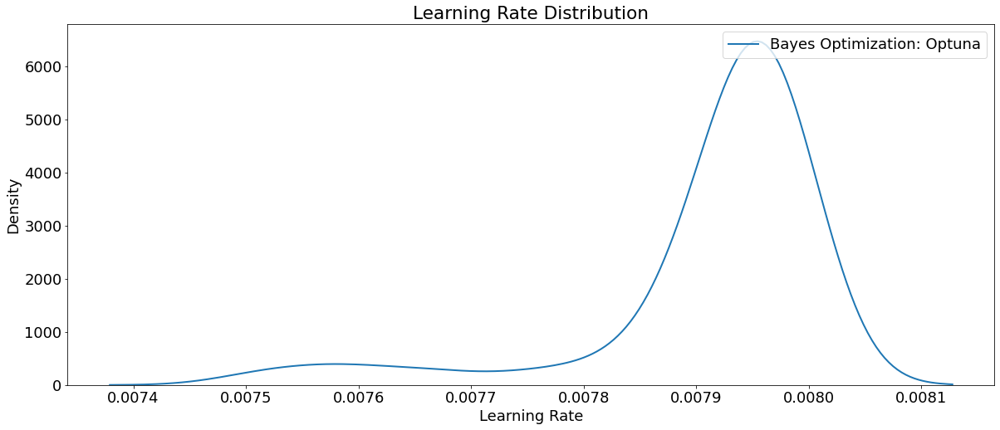

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

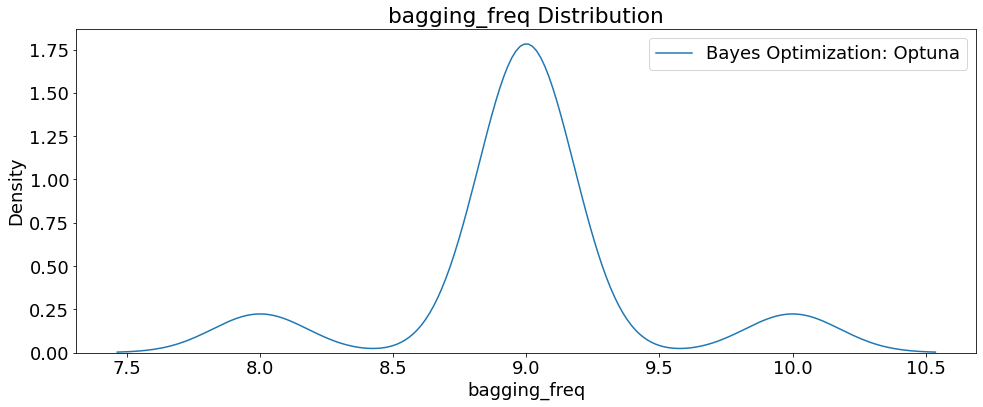

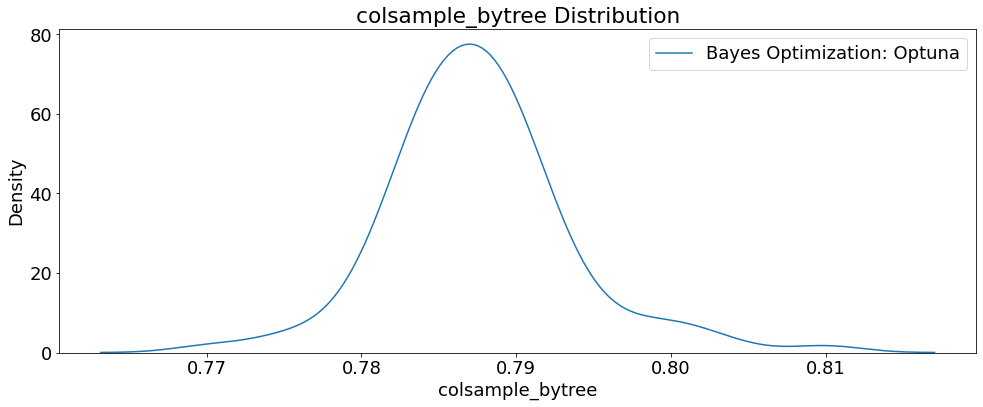

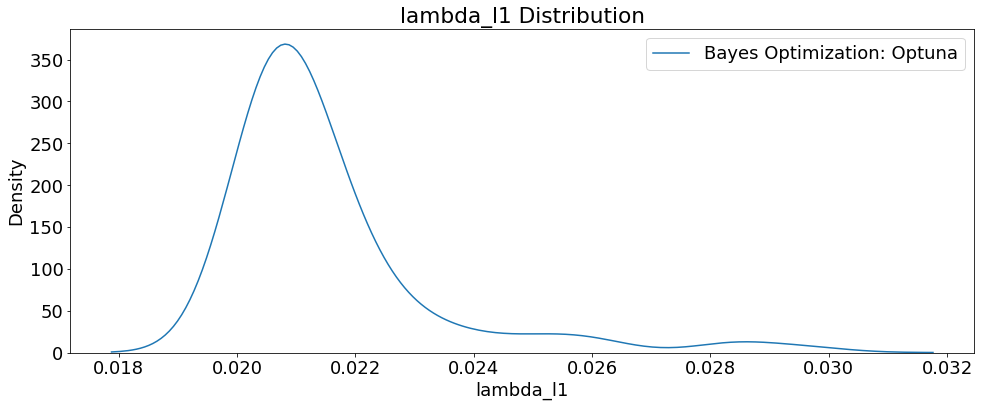

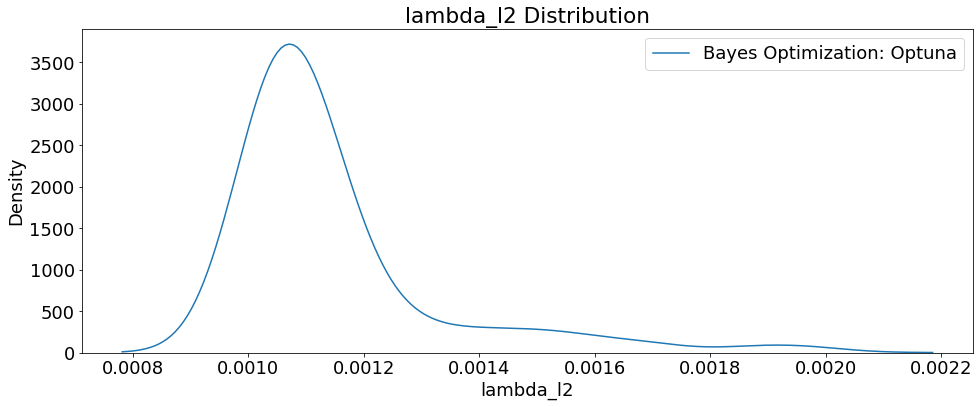

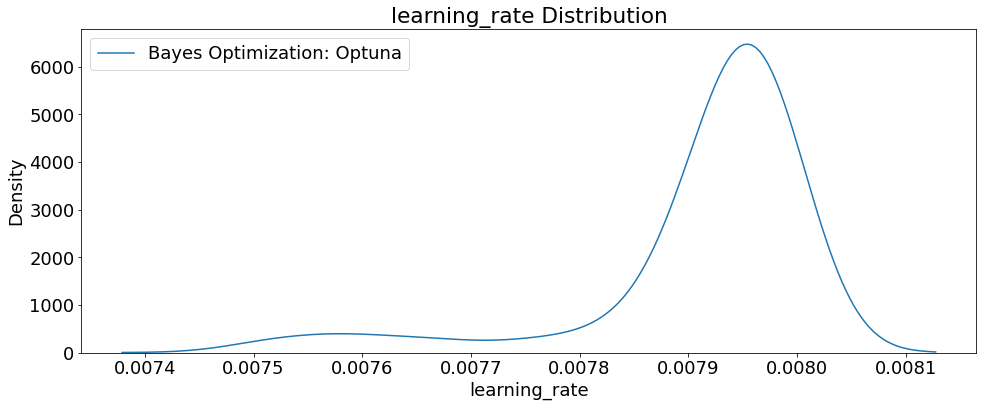

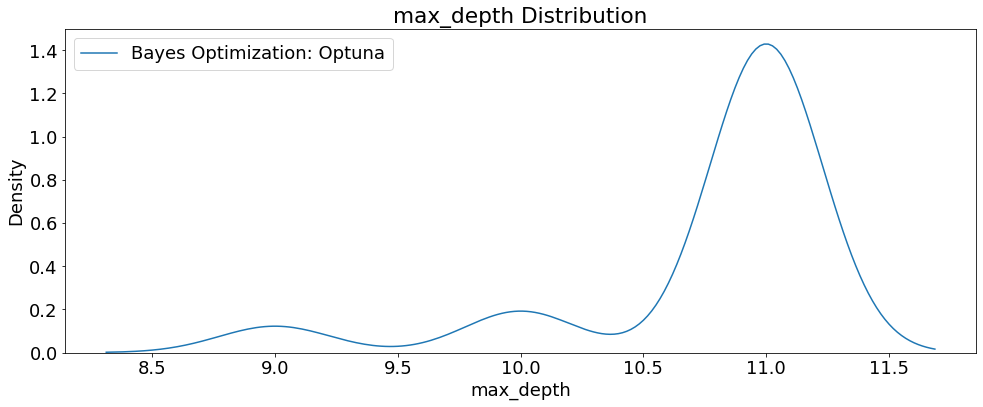

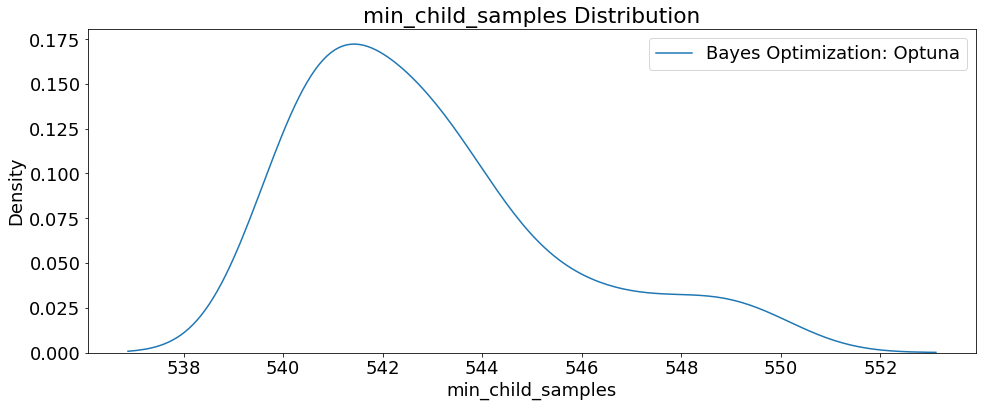

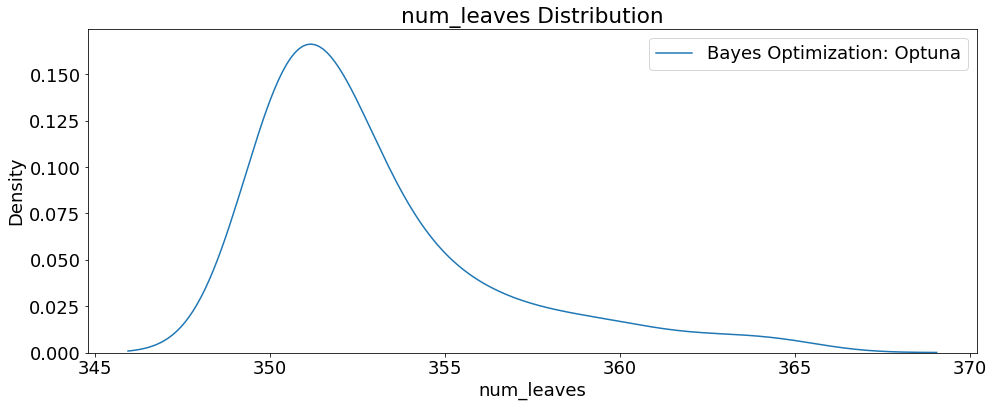

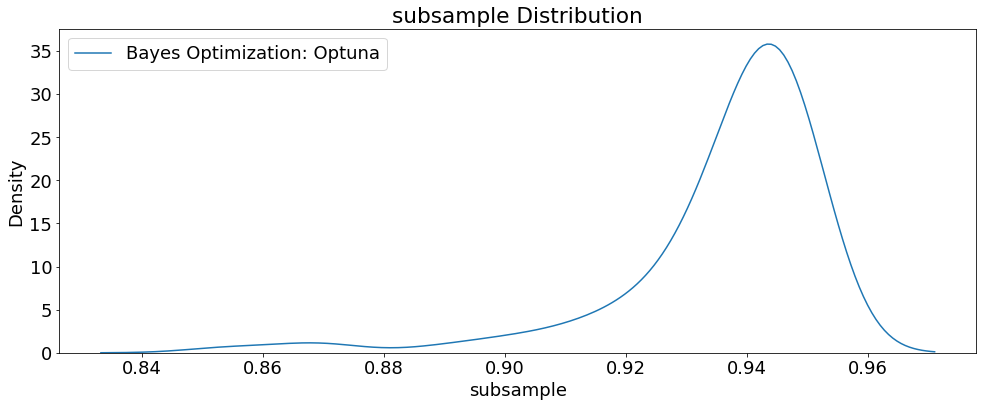

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

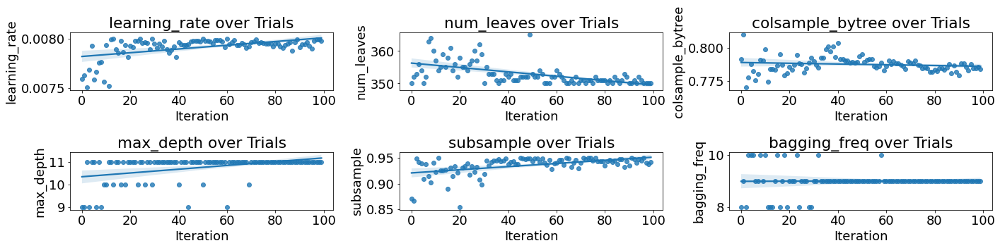

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

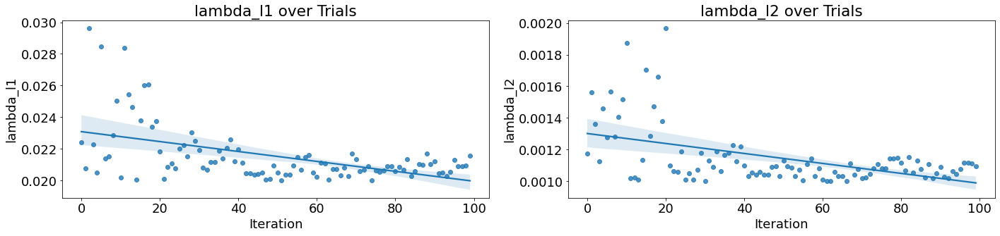

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_RTX4000_wb_trainValTest.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 935,
 'learning_rate': 0.007943157269696874,
 'num_leaves': 350,
 'bagging_freq': 9,
 'subsample': 0.9499843826189689,
 'colsample_bytree': 0.7880330316477893,
 'max_depth': 11,
 'lambda_l1': 0.02046189211067333,
 'lambda_l2': 0.0010249818120010533,
 'min_child_samples': 541,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_RTX4000_wb_trainValTest.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_RTX4000_wb_trainValTest.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.451, test: 1968.953
MSE train: 6814211.670, test: 6977221.333
RMSE train: 2610.405, test: 2641.443
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6977221.33330 MSE on the test set.
This was achieved using these conditions:
iteration                                    91
rmse                                 2682.83656
datetime_start       2023-01-21 17:47:49.211692
datetime_complete    2023-01-21 17:48:17.603528
duration                 0 days 00:00:28.391836
bagging_freq                                  9
colsample_bytree                       0.788033
lambda_l1                              0.020462
lambda_l2                              0.001025
learning_rate                          0.007943
max_depth                                    11
min_child_samples                           541
n_estimators                                935
num_leaves                                  350
subsample                              0.949984
state                                  COMPLETE
Name: 91, dtype: object


# Quadro RTX 5000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
import shap
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_lgbmGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Sat Feb  4 14:40:08 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 5000     Off  | 00000000:00:05.0 Off |                  Off |
| 33%   27C    P8     6W / 230W |      3MiB / 16384MiB |      0%      Default |
|                               |    

## 100 Trials 5-Fold Cross Validation 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_RTX5000_cv_nfold5', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_RTX5000_cv_nfold5'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_RTX5000_wb_5CV.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Create a lgb dataset 
    train_set = lgb.Dataset(train_features, label=train_label, params=params)

    # Start timer for each trial
    start = timer()
      
    # Train the model
    # Perform k_folds cross validation to find lower error
    cv_results = lgb.cv(params, train_set, nfold=5, stratified=False)
    run_time = timer() - start

    # Extract best score
    rmse = round(cv_results['valid rmse-mean'][-1], 4)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX5000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-20 22:31:50.807647


- Trial RMSE: 2705.1343


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2760.3016


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3664


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2711.4794


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2752.3107


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2696.1297


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2719.7772


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2694.828


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2755.3716


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2700.3175


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2713.5157


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2700.5593


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.7607


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2692.4741


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.0343


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2693.1722


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.4408


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6023


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2690.8388


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2717.2575


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.5416


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.3892


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.7333


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.0021


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.7838


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.623


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.4033


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.5893


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2711.3288


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2690.5694


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8229


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


In [ ]:
# Load to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_5CV.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 33
Best trial: {'n_estimators': 934, 'learning_rate': 0.007890735117796602, 'num_leaves': 356, 'bagging_freq': 9, 'subsample': 0.9486135699572597, 'colsample_bytree': 0.7973509510230977, 'max_depth': 11, 'lambda_l1': 0.023423575294429462, 'lambda_l2': 0.0010761060398082778, 'min_child_samples': 541}
Lowest RMSE 2684.8229


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX5000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=78, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-02-04 14:40:44.054830


- Trial RMSE: 2686.5856


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7772


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.5075


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2743.8594


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.6889


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2539


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.6781


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2708.7978


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.2465


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.9126


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9893


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8686


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.1959


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.868


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.5056


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.6904


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2739.4784


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.4423


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.0733


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9996


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9873


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.8392


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.1459


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.4971


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.5694


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8748


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2708.5039


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.8378


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4801


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8122


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.8015


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3789


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.8883


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.6737


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.1787


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.405


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.5764


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7437


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4651


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9268


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.6323


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7726


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.6849


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7096


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.0981


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3908


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.5478


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3764


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.1112


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.0922


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2283


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2740.4841


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.8983


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2859


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3479


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.1335


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.6877


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.5378


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8767


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2282


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.7362


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4338


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.9657


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9752


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.693


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.2221


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2874


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.368


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.5819


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.3873


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3584


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7264


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7564


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.9113


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.289


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.9597


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2559


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4475


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-02-04 14:40:44.054830
End Time             2023-02-04 19:08:59.171626
4:28:15


Number of finished trials: 111
Best trial: {'n_estimators': 933, 'learning_rate': 0.007999560944747458, 'num_leaves': 354, 'bagging_freq': 9, 'subsample': 0.9473654968010763, 'colsample_bytree': 0.7968252135182555, 'max_depth': 11, 'lambda_l1': 0.026090215873239973, 'lambda_l2': 0.0013940485065393297, 'min_child_samples': 540}
Lowest RMSE 2683.289


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_RTX5000_wb_CV.csv', index=False)
print(trials_df) 

     iteration       rmse             datetime_start  \
107        107  2683.2890 2023-02-04 18:55:41.952807   
47          47  2683.5056 2023-02-04 15:30:27.523121   
39          39  2683.6781 2023-02-04 15:01:52.217819   
89          89  2683.6877 2023-02-04 17:52:59.620118   
76          76  2683.7096 2023-02-04 17:08:53.287627   
..         ...        ...                        ...   
36          36  2743.8594 2023-02-04 14:52:28.101658   
4            4  2752.3107 2023-01-20 22:42:55.047211   
8            8  2755.3716 2023-01-20 22:54:45.212795   
1            1  2760.3016 2023-01-20 22:34:45.740987   
32          32        NaN 2023-01-21 00:08:55.758364   

             datetime_complete               duration  bagging_freq  \
107 2023-02-04 18:59:04.434899 0 days 00:03:22.482092           9.0   
47  2023-02-04 15:34:05.407801 0 days 00:03:37.884680           9.0   
39  2023-02-04 15:05:44.313634 0 days 00:03:52.095815           9.0   
89  2023-02-04 17:56:57.870044 0 days 00:03

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_RTX5000_wb_CV.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_RTX5000_wb_CV.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_RTX5000_wb_CV.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_RTX5000_wb_CV.html')
fig.show()

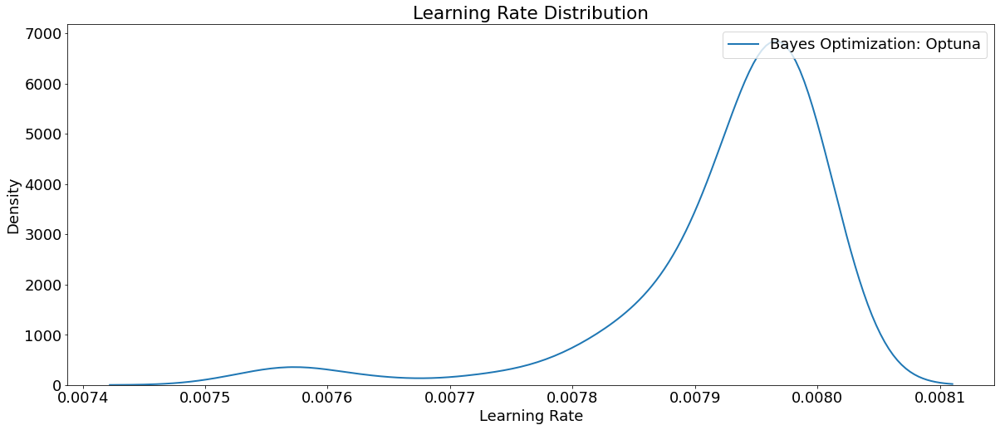

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

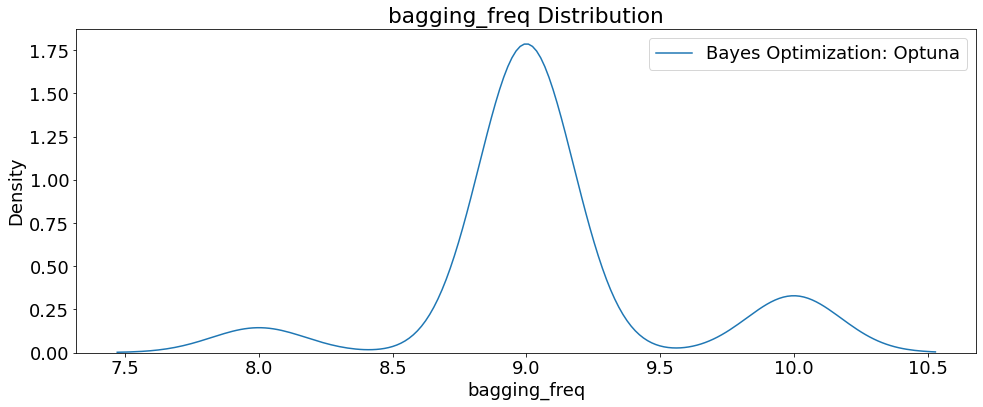

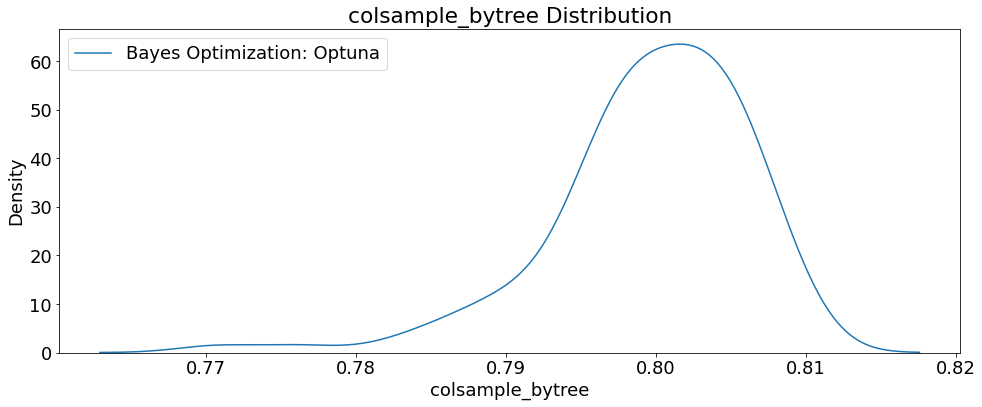

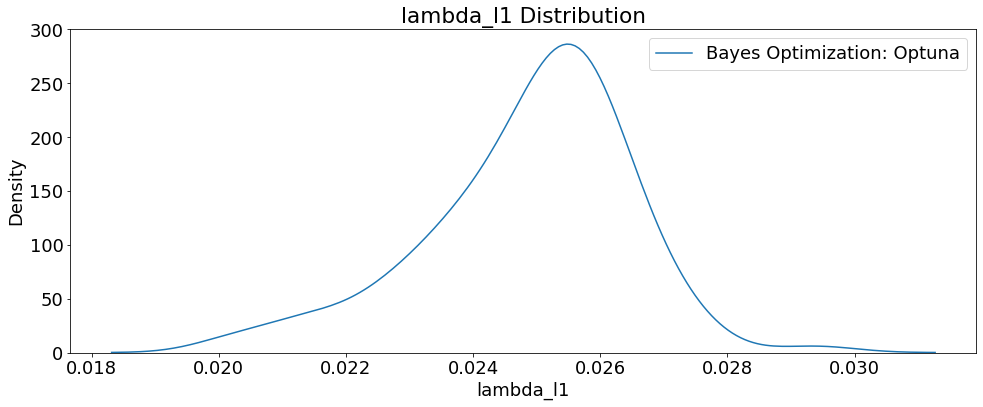

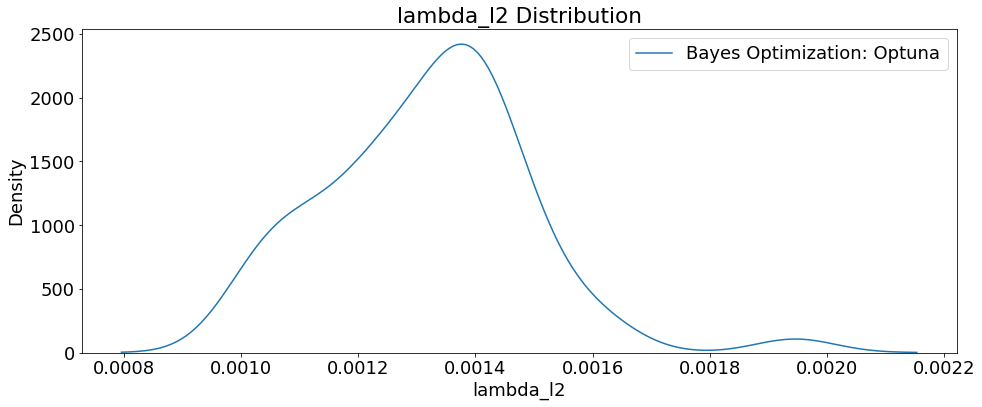

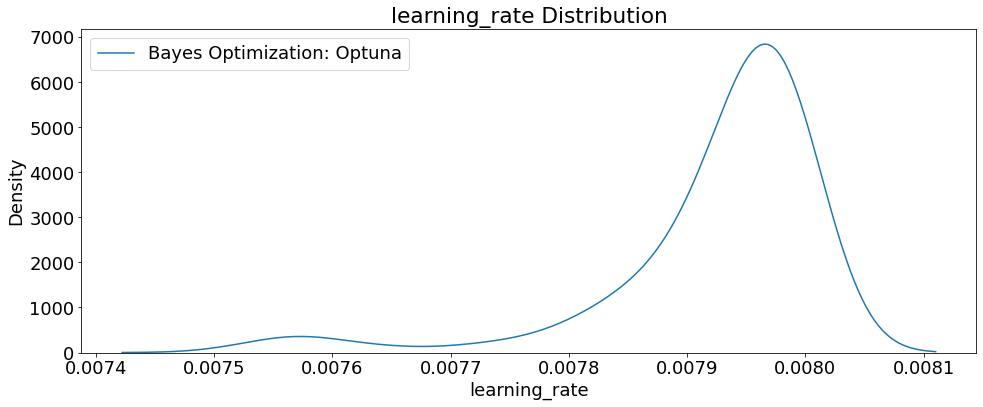

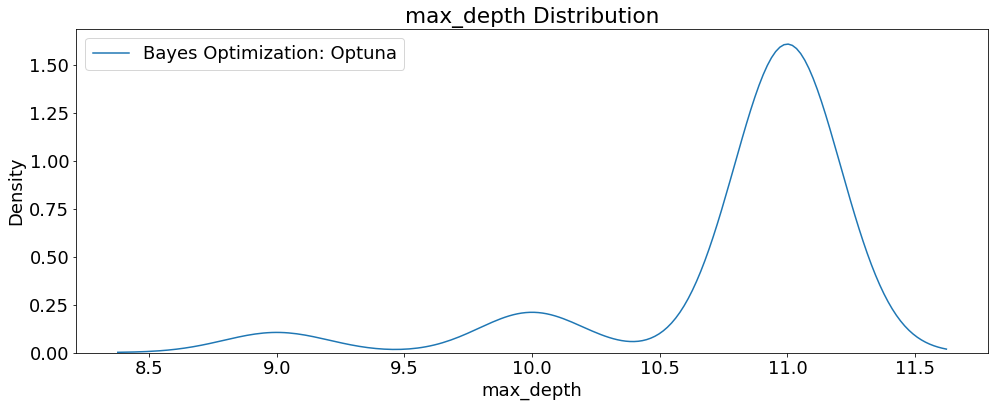

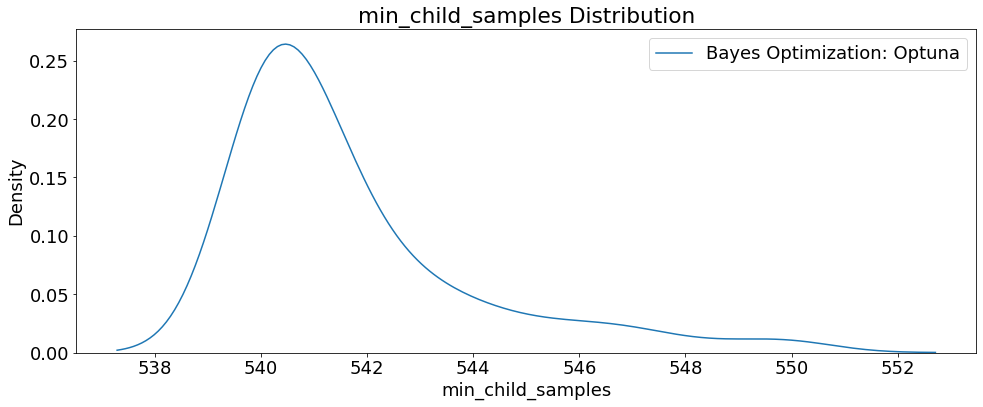

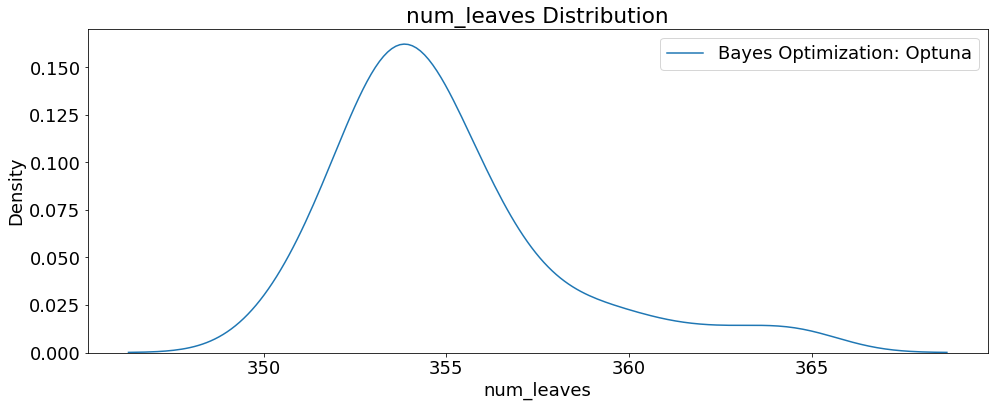

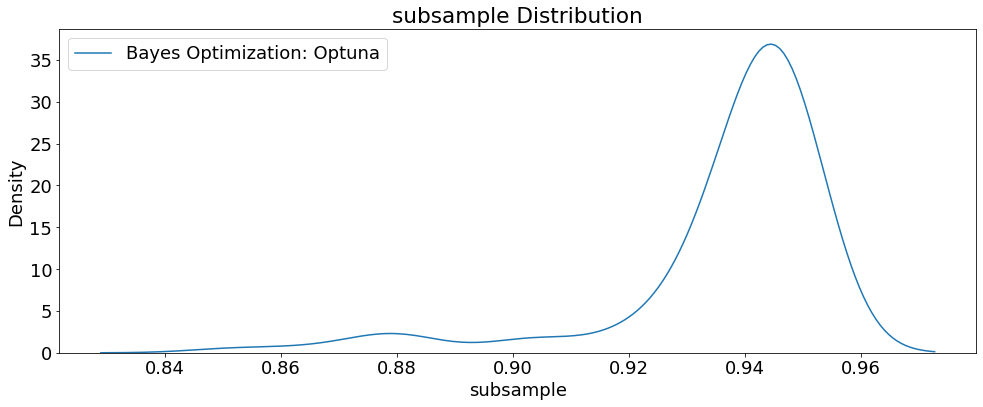

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

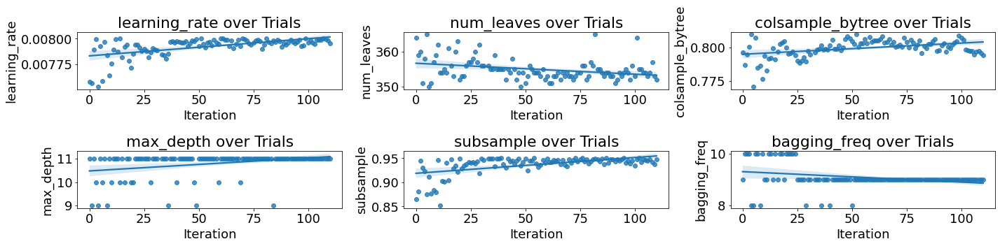

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

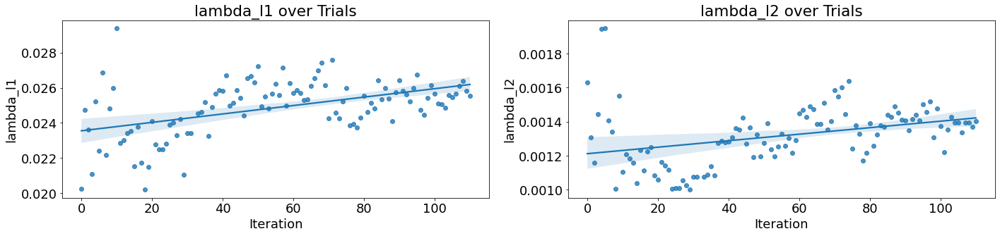

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_RTX5000_wb_CV.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_RTX5000_wb_CV.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 933,
 'learning_rate': 0.007999560944747458,
 'num_leaves': 354,
 'bagging_freq': 9,
 'subsample': 0.9473654968010763,
 'colsample_bytree': 0.7968252135182555,
 'max_depth': 11,
 'lambda_l1': 0.026090215873239973,
 'lambda_l2': 0.0013940485065393297,
 'min_child_samples': 540,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_RTX5000_wb_CV.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_RTX5000_wb_CV.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1944.888, test: 1968.541
MSE train: 6810192.726, test: 6971279.030
RMSE train: 2609.635, test: 2640.318
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6971279.03037 MSE on the test set.
This was achieved using these conditions:
iteration                                   107
rmse                                   2683.289
datetime_start       2023-02-04 18:55:41.952807
datetime_complete    2023-02-04 18:59:04.434899
duration                 0 days 00:03:22.482092
bagging_freq                                9.0
colsample_bytree                       0.796825
lambda_l1                               0.02609
lambda_l2                              0.001394
learning_rate                             0.008
max_depth                                  11.0
min_child_samples                         540.0
n_estimators                              933.0
num_leaves                                354.0
subsample                              0.947365
state                                  COMPLETE
Name: 107, dtype: object


## 100 Trials Train/Validation/Test 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_RTX5000_trainValTest_kfold10', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_RTX5000_trainValTest_kfold10'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Set same k-folds for reproducibility
    kf = KFold(n_splits=10, shuffle=True, random_state=seed_value)

    # Create train and validation sets
    for trn_idx, val_idx in kf.split(trainDF[features], train_label): 
        train_Features, train_Label = trainDF[features].iloc[trn_idx], train_label.iloc[trn_idx]
        val_Features, val_Label = trainDF[features].iloc[val_idx], train_label.iloc[val_idx] 

      # Define model
      model = LGBMRegressor(**params)

      # Start timer for each trial
      start = timer()
      
      # Train the model
      model.fit(train_Features, train_Label, 
                eval_set = [(val_Features, val_Label), 
                            (train_Features, train_Label)]) 
      run_time = timer() - start

      # Predictions
      y_pred_val = model.predict(val_Features)
      rmse = mean_squared_error(val_Label, y_pred_val, squared=False)
      
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-20 12:53:46.070407


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


In [ ]:
# Load to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 65
Best trial: {'n_estimators': 935, 'learning_rate': 0.00788569139344744, 'num_leaves': 362, 'bagging_freq': 8, 'subsample': 0.9486212414396782, 'colsample_bytree': 0.7967075552184071, 'max_depth': 11, 'lambda_l1': 0.028098572451416122, 'lambda_l2': 0.0016495019350809413, 'min_child_samples': 540}
Lowest RMSE 2666.5235318621803


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=26, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-20 18:29:25.897921


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-20 18:29:25.897921
End Time             2023-01-20 20:27:05.276413
1:57:39


Number of finished trials: 91
Best trial: {'n_estimators': 934, 'learning_rate': 0.00799798322419134, 'num_leaves': 365, 'bagging_freq': 8, 'subsample': 0.9437235474178448, 'colsample_bytree': 0.7957698499211322, 'max_depth': 11, 'lambda_l1': 0.02709918284263254, 'lambda_l2': 0.001732350638007959, 'min_child_samples': 542}
Lowest RMSE 2666.298840069562


In [ ]:
# Load to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 91
Best trial: {'n_estimators': 934, 'learning_rate': 0.00799798322419134, 'num_leaves': 365, 'bagging_freq': 8, 'subsample': 0.9437235474178448, 'colsample_bytree': 0.7957698499211322, 'max_depth': 11, 'lambda_l1': 0.02709918284263254, 'lambda_l2': 0.001732350638007959, 'min_child_samples': 542}
Lowest RMSE 2666.298840069562


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-20 21:24:00.998792


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-20 21:24:00.998792
End Time             2023-01-20 22:08:20.975519
0:44:19


Number of finished trials: 101
Best trial: {'n_estimators': 935, 'learning_rate': 0.007992731646593311, 'num_leaves': 364, 'bagging_freq': 8, 'subsample': 0.9420251694290137, 'colsample_bytree': 0.7977796306125468, 'max_depth': 11, 'lambda_l1': 0.027573098144261537, 'lambda_l2': 0.0017545589804414568, 'min_child_samples': 542}
Lowest RMSE 2665.822710646012


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
93         93  2665.822711 2023-01-20 21:32:40.109313   
87         87  2666.298840 2023-01-20 20:09:06.922795   
83         83  2666.398729 2023-01-20 19:49:56.755938   
42         42  2666.523532 2023-01-20 16:23:40.603202   
44         44  2666.797668 2023-01-20 16:33:13.711260   
..        ...          ...                        ...   
2           2  2739.760144 2023-01-20 13:03:00.546534   
9           9  2742.315155 2023-01-20 13:34:29.657981   
3           3  2743.126159 2023-01-20 13:07:26.647289   
64         64          NaN 2023-01-20 18:06:28.831970   
90         90          NaN 2023-01-20 20:22:38.045543   

            datetime_complete               duration  bagging_freq  \
93 2023-01-20 21:37:12.639507 0 days 00:04:32.530194           8.0   
87 2023-01-20 20:13:37.855283 0 days 00:04:30.932488           8.0   
83 2023-01-20 19:54:32.098193 0 days 00:04:35.342255           8.0   
42 2023-01-20 16:28:15.733265 0 day

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


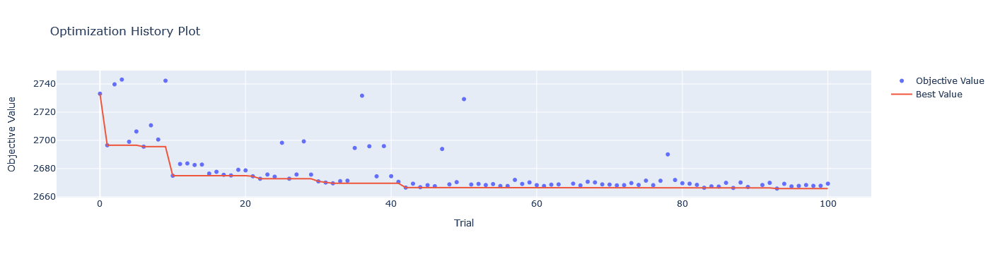

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.html')
fig.show()

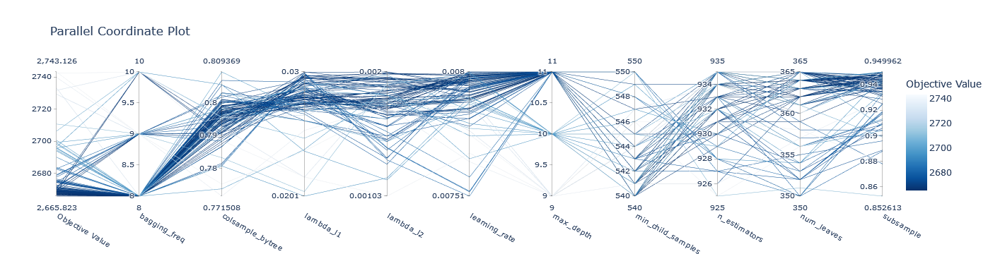

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.html')
fig.show()

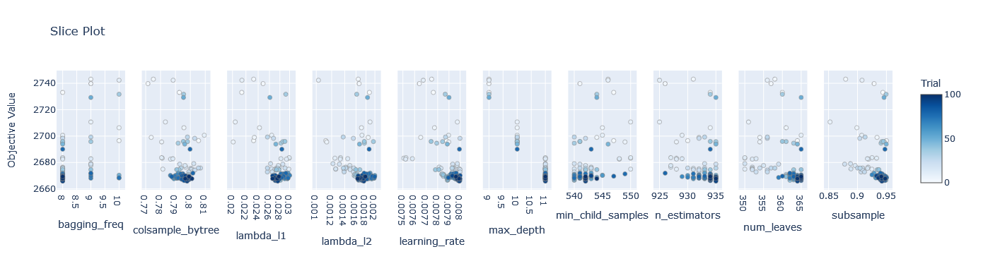

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.html')
fig.show()

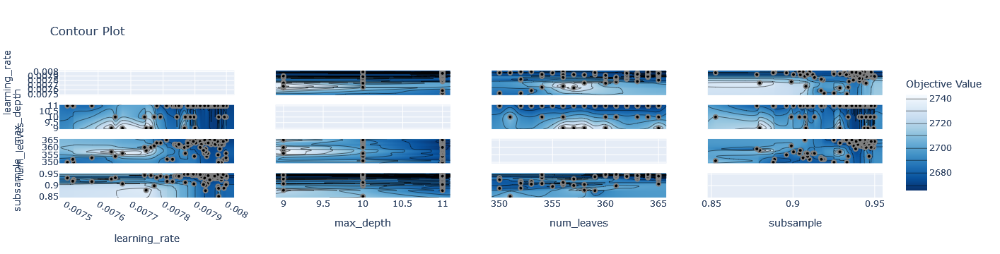

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.html')
fig.show()

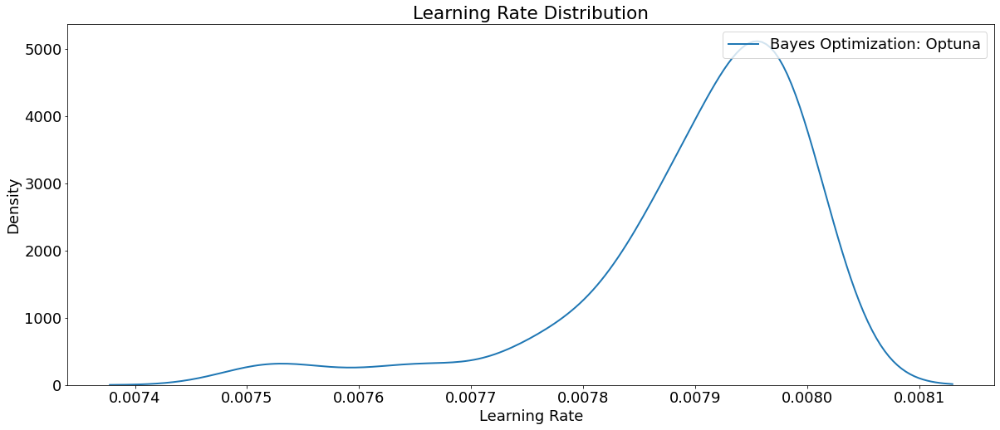

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

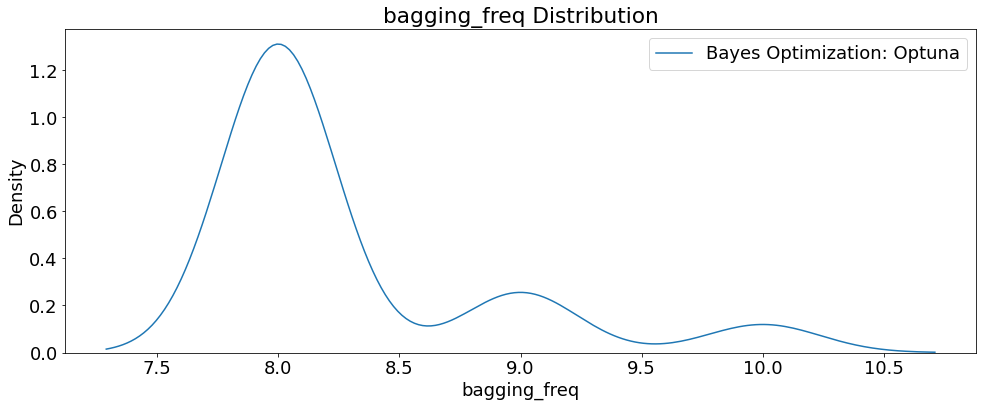

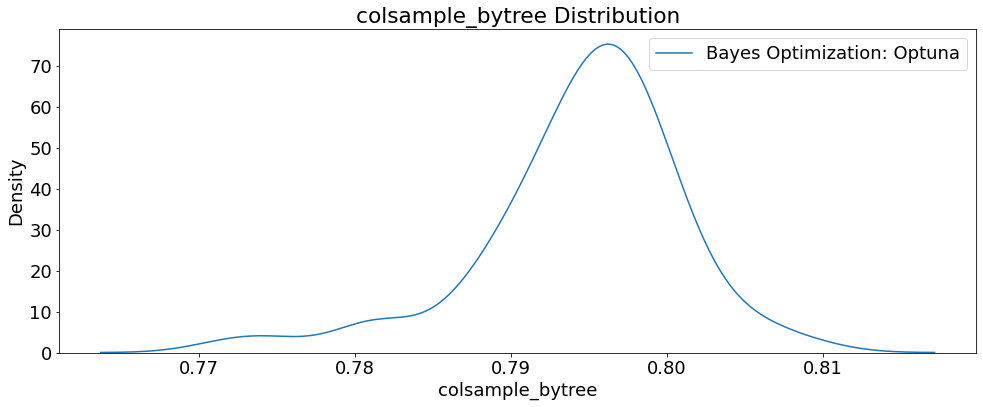

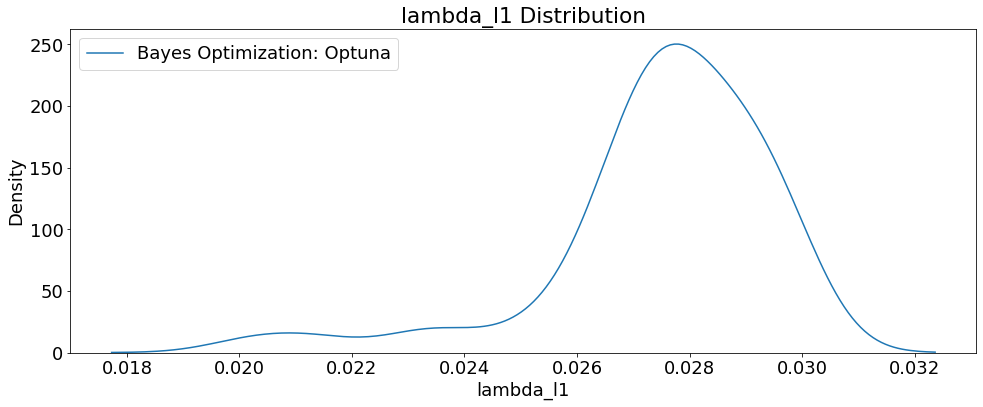

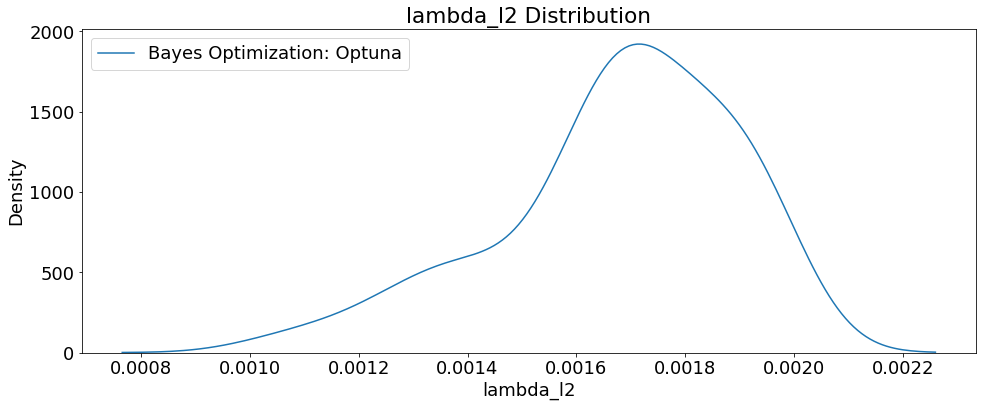

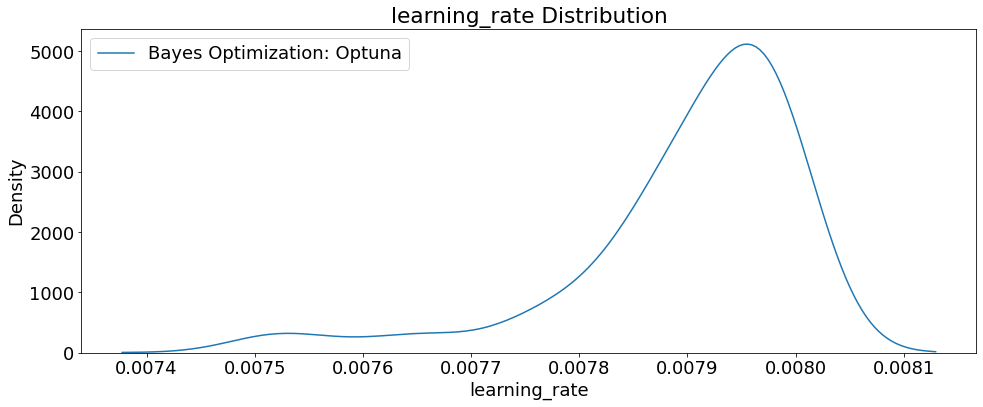

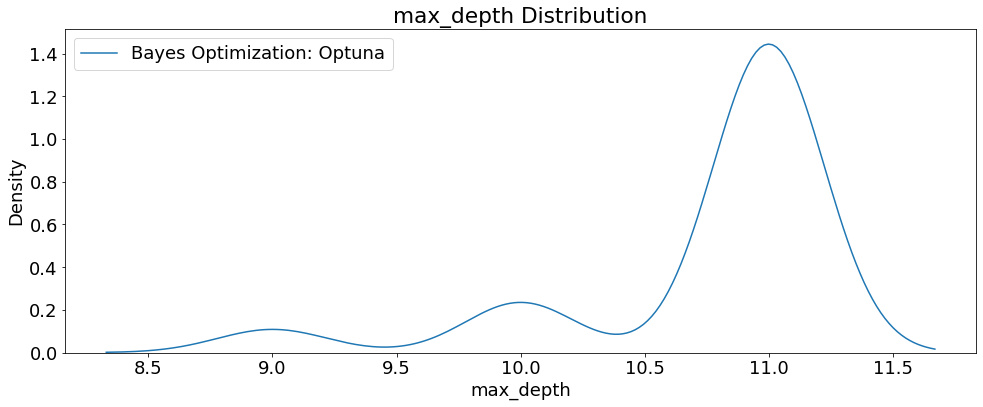

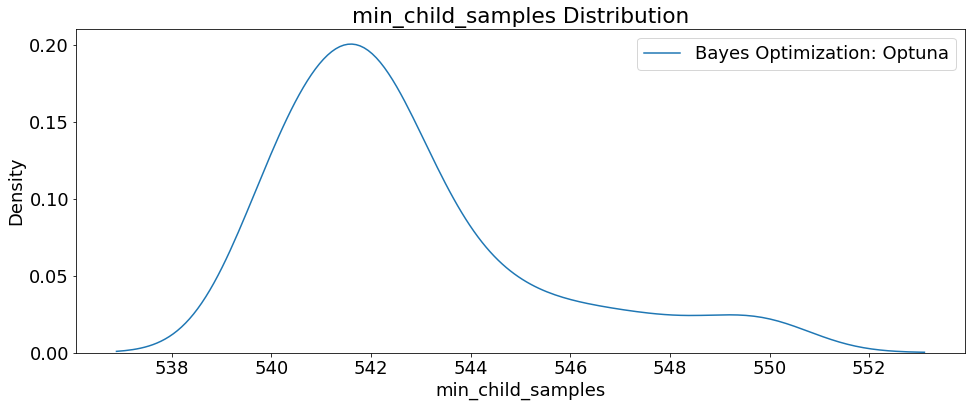

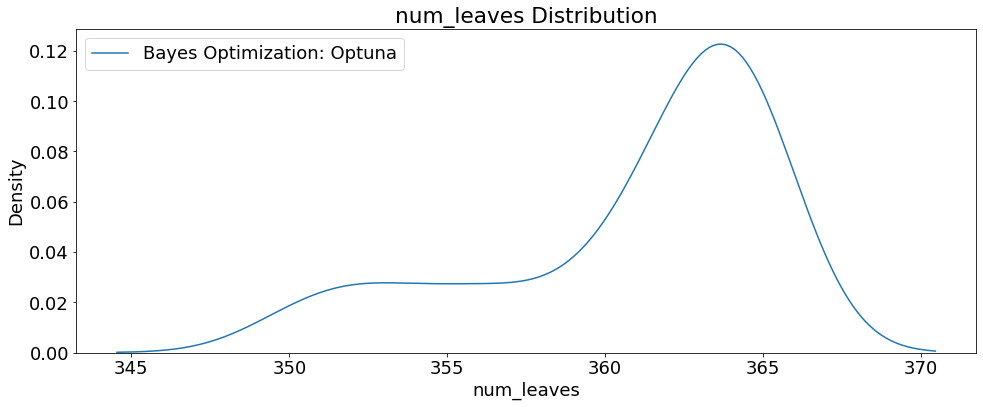

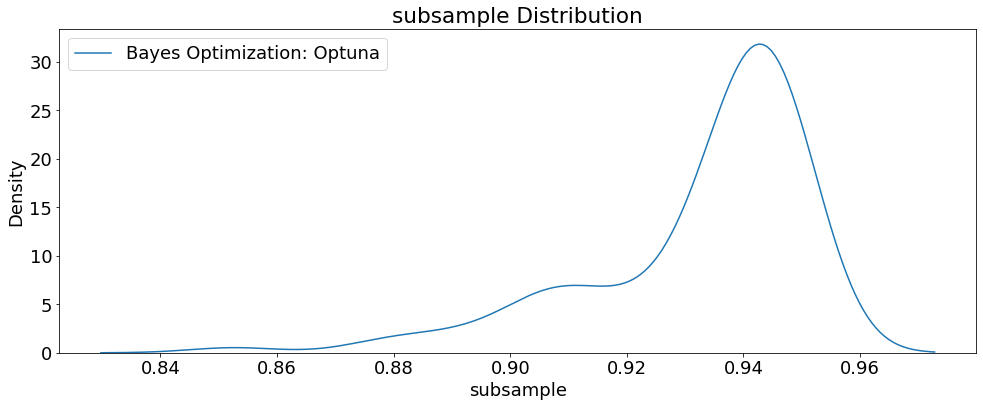

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

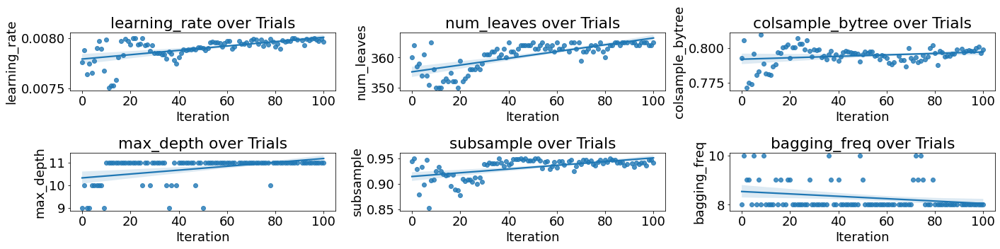

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

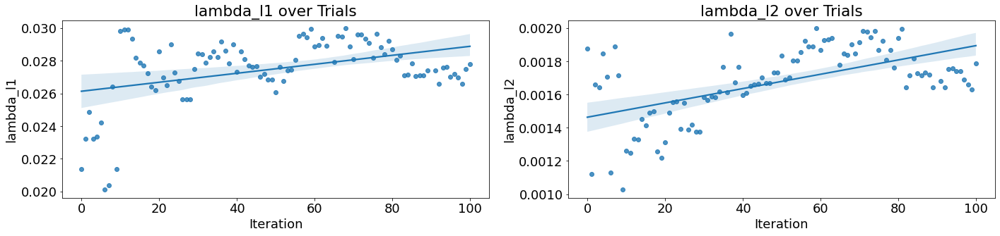

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

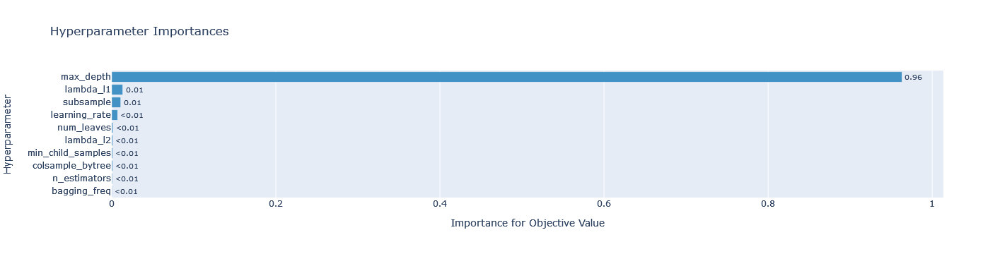

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.html')
fig.show()

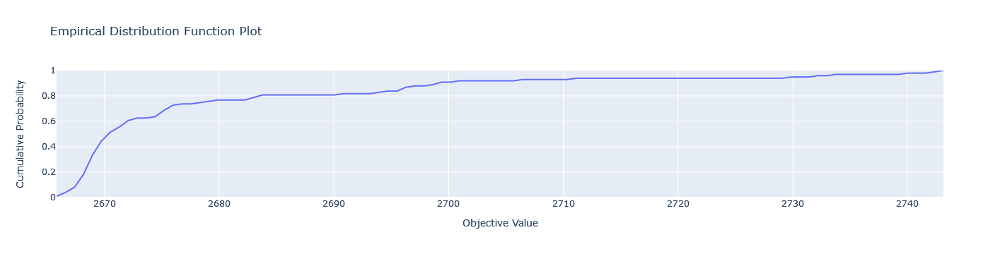

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_RTX5000_wb_trainValTest.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 935,
 'learning_rate': 0.007992731646593311,
 'num_leaves': 364,
 'bagging_freq': 8,
 'subsample': 0.9420251694290137,
 'colsample_bytree': 0.7977796306125468,
 'max_depth': 11,
 'lambda_l1': 0.027573098144261537,
 'lambda_l2': 0.0017545589804414568,
 'min_child_samples': 542,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_RTX5000_wb_trainValTest.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials1000_GPU_RTX5000_wb_trainValTest.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.448, test: 1969.281
MSE train: 6813729.202, test: 6975404.060
RMSE train: 2610.312, test: 2641.099
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6975404.06008 MSE on the test set.
This was achieved using these conditions:
iteration                                    93
rmse                                2665.822711
datetime_start       2023-01-20 21:32:40.109313
datetime_complete    2023-01-20 21:37:12.639507
duration                 0 days 00:04:32.530194
bagging_freq                                8.0
colsample_bytree                        0.79778
lambda_l1                              0.027573
lambda_l2                              0.001755
learning_rate                          0.007993
max_depth                                  11.0
min_child_samples                         542.0
n_estimators                              935.0
num_leaves                                364.0
subsample                              0.942025
state                                  COMPLETE
Name: 93, dtype: object


# RTX A4000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
import shap
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_lgbmGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Thu Jan 19 20:00:43 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA RTX A4000    Off  | 00000000:00:05.0 Off |                  Off |
| 41%   38C    P8    14W / 140W |      2MiB / 16376MiB |      0%      Default |
|                               |    

## 100 Trials 5-Fold Cross Validation 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_A4000_cv_nfold5', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_A4000_cv_nfold5'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_A4000_wb_5CV.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Create a lgb dataset 
    train_set = lgb.Dataset(train_features, label=train_label, params=params)

    # Start timer for each trial
    start = timer()
      
    # Train the model
    # Perform k_folds cross validation to find lower error
    cv_results = lgb.cv(params, train_set, nfold=5, stratified=False)
    run_time = timer() - start

    # Extract best score
    rmse = round(cv_results['valid rmse-mean'][-1], 4)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_A4000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_A4000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-19 21:16:22.697111


- Trial RMSE: 2749.1244


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2717.2084


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2692.9784


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2692.8383


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2698.6673


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2699.8207


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.3333


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2697.2226


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2754.293


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2711.8184


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.7875


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.8499


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.8472


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2713.1223


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.7735


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2711.5477


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.6963


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2744.1765


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2694.1539


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2712.4033


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.2735


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.4448


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.4869


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6866


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.4653


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.9401


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.4685


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2708.8537


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.5751


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2748.2009


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2691.2704


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6596


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.0332


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.8898


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.9609


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.6114


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.8797


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.5328


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.5074


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2690.28


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2714.0988


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.2339


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.7198


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.8956


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.9304


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.7202


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2693.4033


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.2454


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.8045


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.8095


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2352


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.874


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.5698


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.6362


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.0392


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.6055


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.3476


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.3479


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6175


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6014


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2711.5233


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7914


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2708


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.5041


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.9339


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2742.2843


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.6558


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.0458


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.6881


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2161


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.468


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.941


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2199


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.6489


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.2713


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.3918


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.4182


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7624


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7738


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.9599


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.9072


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7552


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.5379


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.1812


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.8945


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.1934


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.0916


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.5241


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8221


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.6036


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.332


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2683.7322


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.1976


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.4538


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.0661


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_A4000_wb_CV.csv', index=False)
print(trials_df) 

    iteration       rmse             datetime_start  \
75         75  2683.3918 2023-01-20 00:46:18.973969   
76         76  2683.4182 2023-01-20 00:49:17.863441   
87         87  2683.5241 2023-01-20 01:19:59.552768   
73         73  2683.6489 2023-01-20 00:40:21.777127   
91         91  2683.7322 2023-01-20 01:31:11.160464   
..        ...        ...                        ...   
17         17  2744.1765 2023-01-19 22:05:22.303172   
29         29  2748.2009 2023-01-19 22:39:01.838755   
0           0  2749.1244 2023-01-19 21:16:22.704453   
8           8  2754.2930 2023-01-19 21:36:57.666656   
96         96        NaN 2023-01-20 01:45:04.236751   

            datetime_complete               duration  bagging_freq  \
75 2023-01-20 00:49:08.438823 0 days 00:02:49.464854           8.0   
76 2023-01-20 00:51:53.026342 0 days 00:02:35.162901           8.0   
87 2023-01-20 01:22:36.310831 0 days 00:02:36.758063           8.0   
73 2023-01-20 00:43:05.760404 0 days 00:02:43.983277       

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_A4000_wb_CV.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_A4000_wb_CV.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_A4000_wb_CV.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_A4000_wb_CV.html')
fig.show()

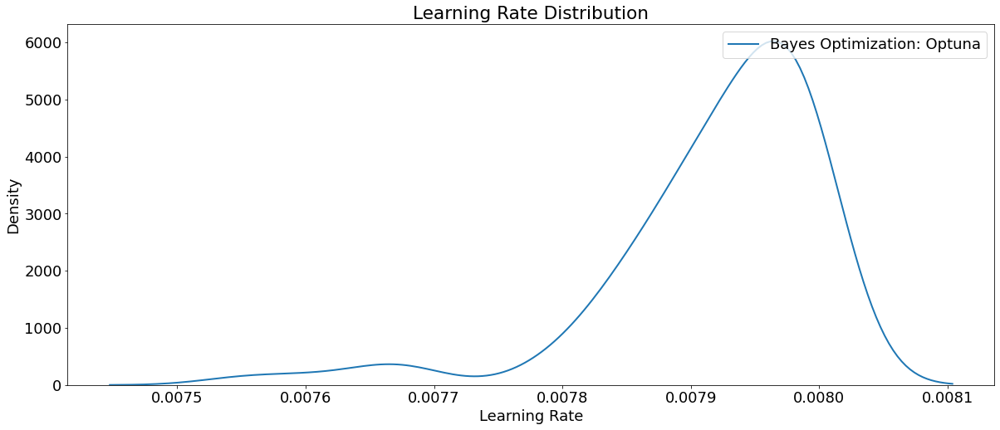

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

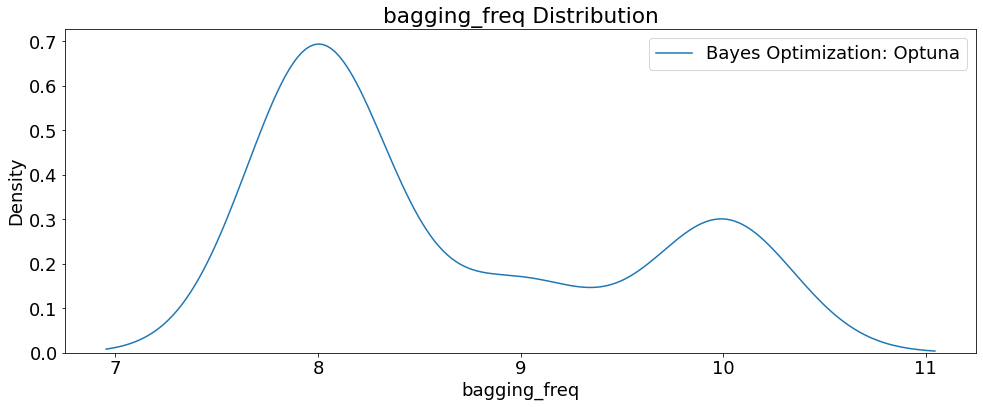

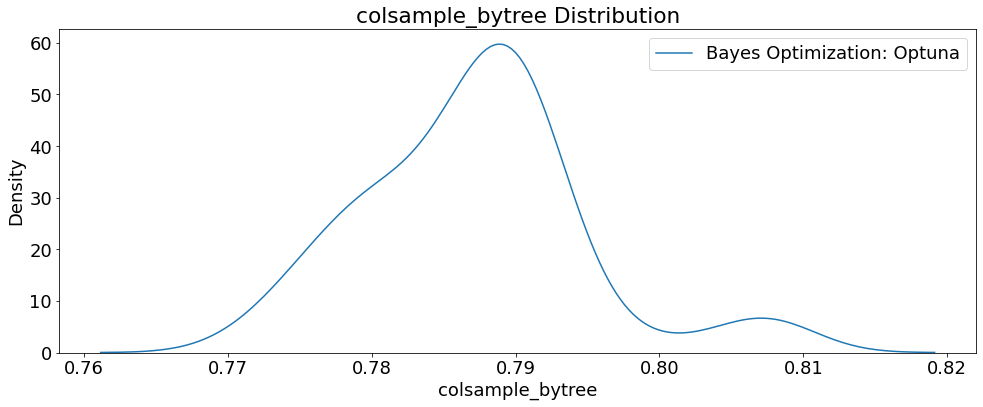

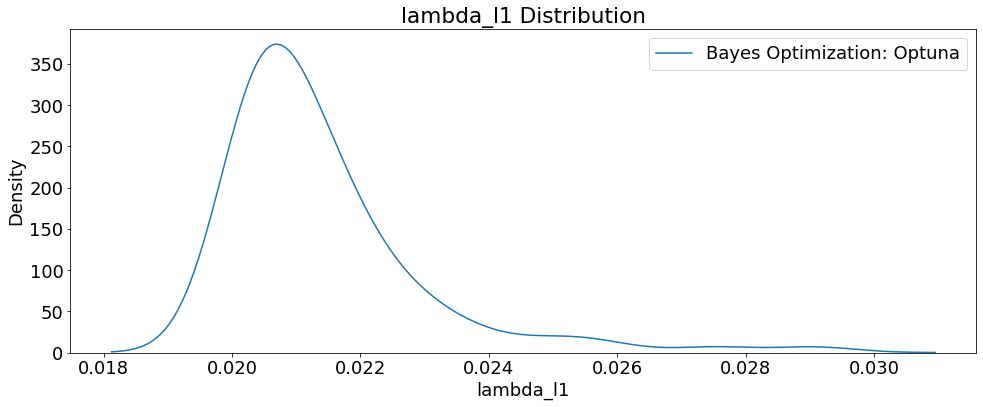

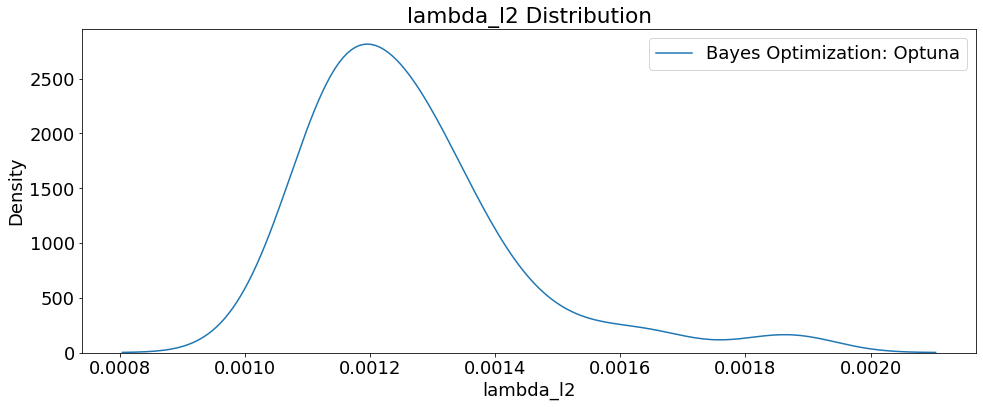

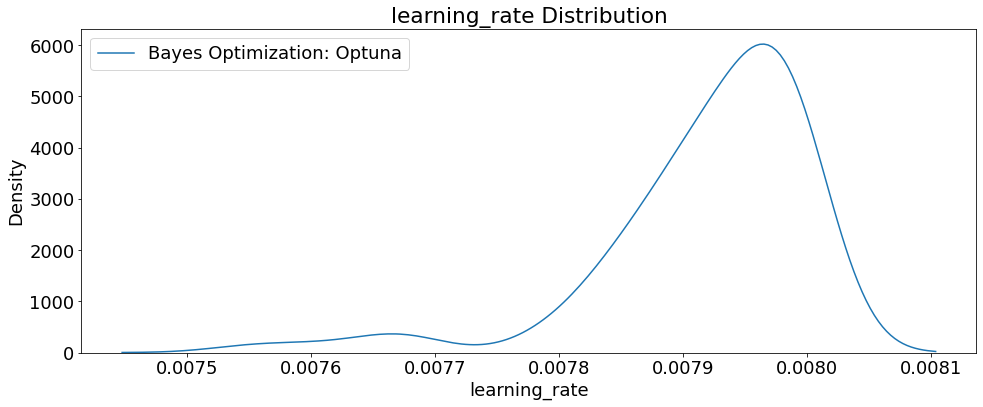

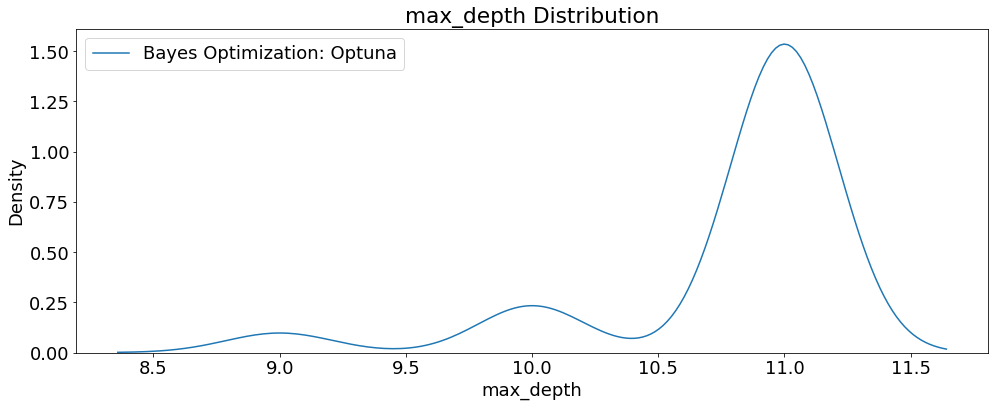

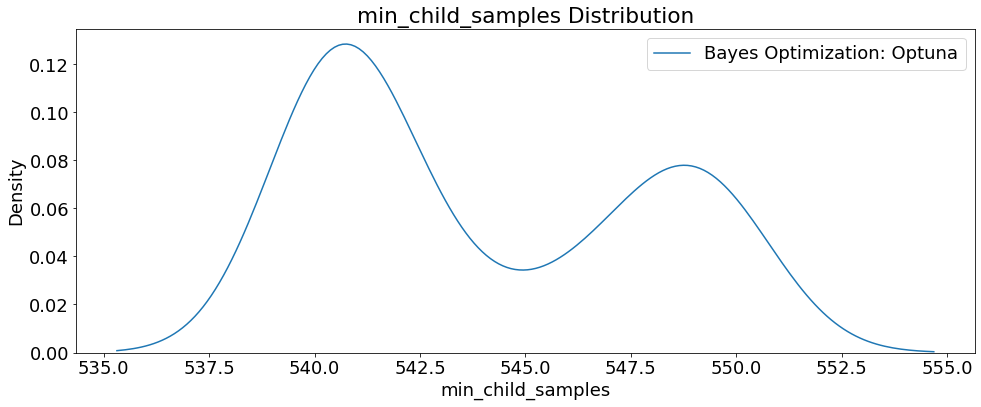

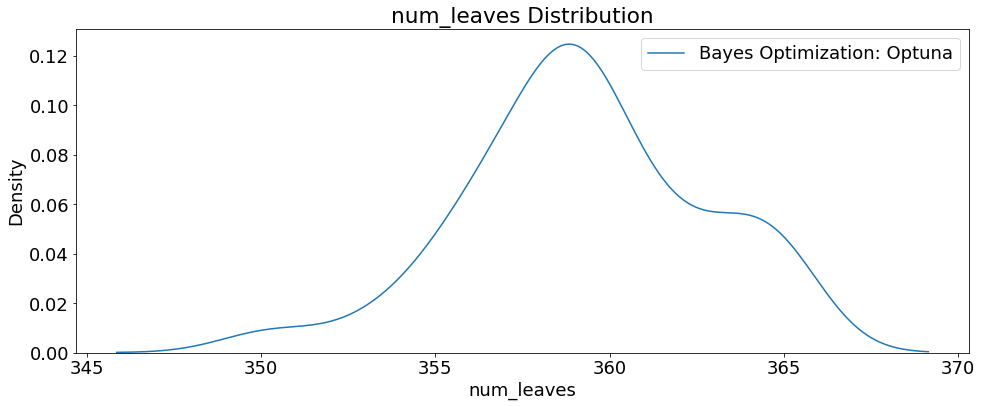

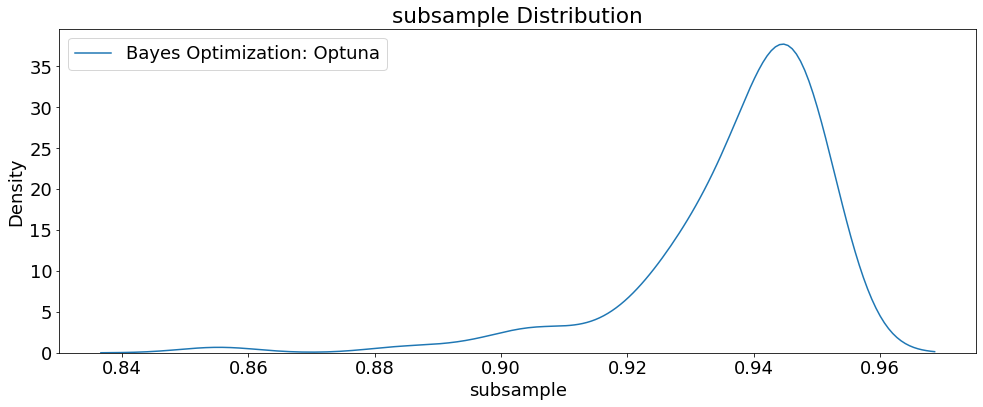

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

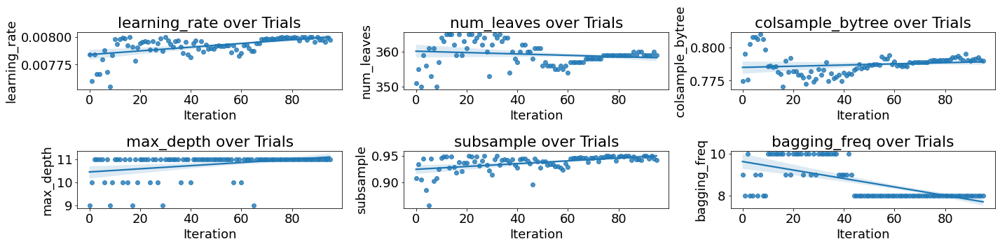

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

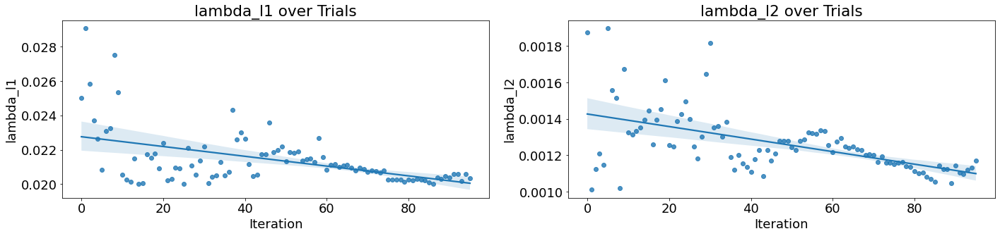

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_A4000_wb_CV.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_A4000_wb_CV.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 933,
 'learning_rate': 0.00799366990237335,
 'num_leaves': 359,
 'bagging_freq': 8,
 'subsample': 0.9498255188690254,
 'colsample_bytree': 0.790321381601683,
 'max_depth': 11,
 'lambda_l1': 0.020277596404023806,
 'lambda_l2': 0.001149665265378832,
 'min_child_samples': 540,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_A4000_wb_CV.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_A4000_wb_CV.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.227, test: 1968.079
MSE train: 6809765.832, test: 6965450.765
RMSE train: 2609.553, test: 2639.214
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6965450.76530 MSE on the test set.
This was achieved using these conditions:
iteration                                    75
rmse                                  2683.3918
datetime_start       2023-01-20 00:46:18.973969
datetime_complete    2023-01-20 00:49:08.438823
duration                 0 days 00:02:49.464854
bagging_freq                                8.0
colsample_bytree                       0.790321
lambda_l1                              0.020278
lambda_l2                               0.00115
learning_rate                          0.007994
max_depth                                  11.0
min_child_samples                         540.0
n_estimators                              933.0
num_leaves                                359.0
subsample                              0.949826
state                                  COMPLETE
Name: 75, dtype: object


## 100 Trials Train/Validation/Test 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_A4000_trainValTest_kfold10', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_A4000_trainValTest_kfold10'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_A4000_wb_trainValSplit.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Set same k-folds for reproducibility
    kf = KFold(n_splits=10, shuffle=True, random_state=seed_value)

    # Create train and validation sets
    for trn_idx, val_idx in kf.split(trainDF[features], train_label): 
        train_Features, train_Label = trainDF[features].iloc[trn_idx], train_label.iloc[trn_idx]
        val_Features, val_Label = trainDF[features].iloc[val_idx], train_label.iloc[val_idx] 

      # Define model
      model = LGBMRegressor(**params)

      # Start timer for each trial
      start = timer()
      
      # Train the model
      model.fit(train_Features, train_Label, 
                eval_set = [(val_Features, val_Label), 
                            (train_Features, train_Label)]) 
      run_time = timer() - start

      # Predictions
      y_pred_val = model.predict(val_Features)
      rmse = mean_squared_error(val_Label, y_pred_val, squared=False)
      
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_A4000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_A4000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-19 13:06:49.634630


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


In [ ]:
# Load to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_A4000_wb_trainValSplit.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 87
Best trial: {'n_estimators': 935, 'learning_rate': 0.007984853295875446, 'num_leaves': 355, 'bagging_freq': 8, 'subsample': 0.9438207911781291, 'colsample_bytree': 0.7956219126001296, 'max_depth': 11, 'lambda_l1': 0.02492318962109757, 'lambda_l2': 0.0011435365417320647, 'min_child_samples': 542}
Lowest RMSE 2665.9917463847464


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_A4000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_A4000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=14, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-19 20:01:31.225883


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-19 20:01:31.225883
End Time             2023-01-19 20:56:49.090228
0:55:17


Number of finished trials: 101
Best trial: {'n_estimators': 935, 'learning_rate': 0.007984853295875446, 'num_leaves': 355, 'bagging_freq': 8, 'subsample': 0.9438207911781291, 'colsample_bytree': 0.7956219126001296, 'max_depth': 11, 'lambda_l1': 0.02492318962109757, 'lambda_l2': 0.0011435365417320647, 'min_child_samples': 542}
Lowest RMSE 2665.9917463847464


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
68         68  2665.991746 2023-01-19 17:27:40.430412   
65         65  2666.121005 2023-01-19 17:15:13.913028   
85         85  2666.433735 2023-01-19 18:40:00.356354   
98         98  2666.941256 2023-01-19 20:45:13.393011   
83         83  2666.948847 2023-01-19 18:31:12.398431   
..        ...          ...                        ...   
17         17  2728.509689 2023-01-19 14:07:50.358017   
37         37  2729.399324 2023-01-19 15:20:39.753361   
3           3  2730.999057 2023-01-19 13:17:24.015980   
4           4  2745.517061 2023-01-19 13:20:20.061339   
86         86          NaN 2023-01-19 18:44:10.982965   

            datetime_complete               duration  bagging_freq  \
68 2023-01-19 17:31:45.926620 0 days 00:04:05.496208           8.0   
65 2023-01-19 17:19:15.702591 0 days 00:04:01.789563           8.0   
85 2023-01-19 18:44:05.790380 0 days 00:04:05.434026           8.0   
98 2023-01-19 20:49:10.375167 0 day

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.html')
fig.show()

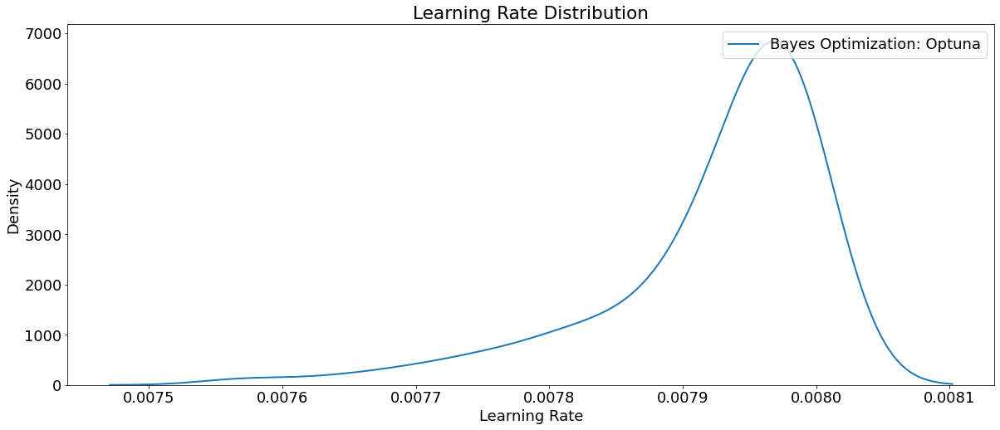

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

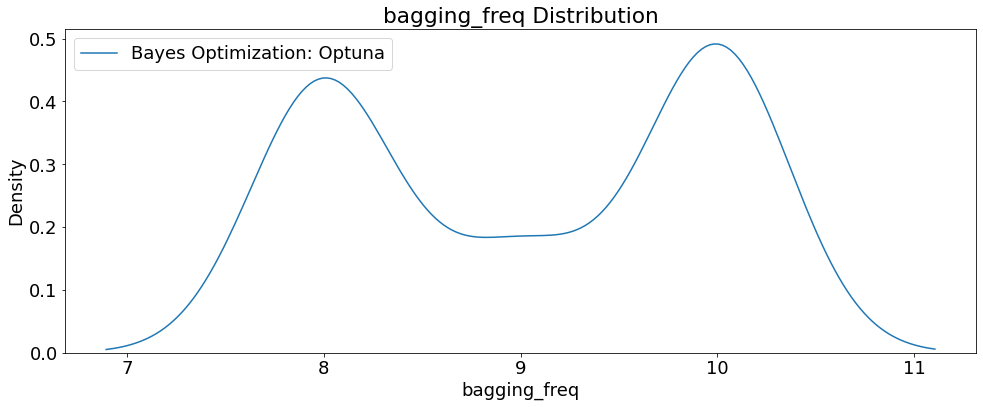

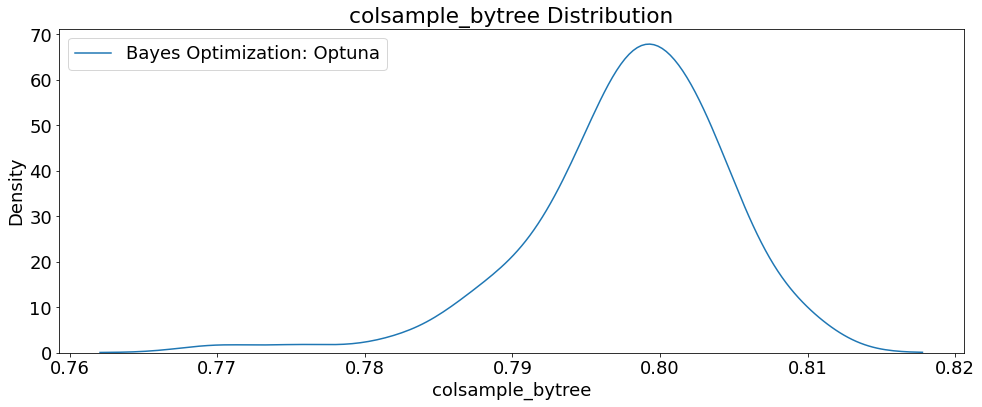

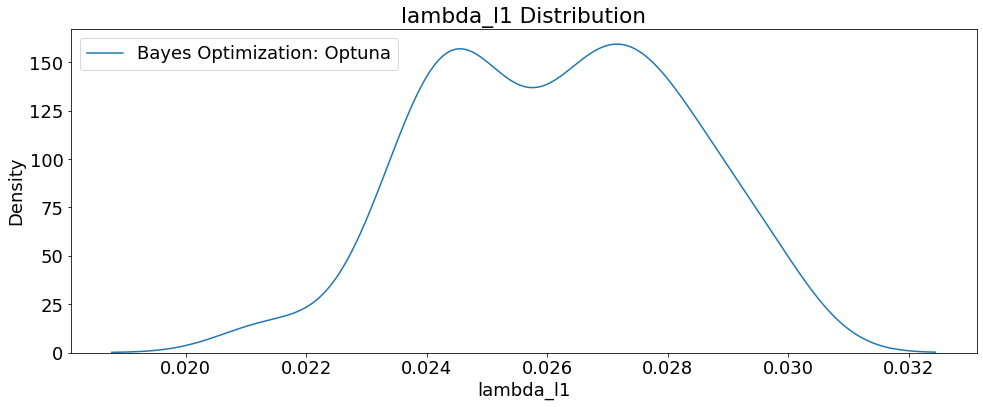

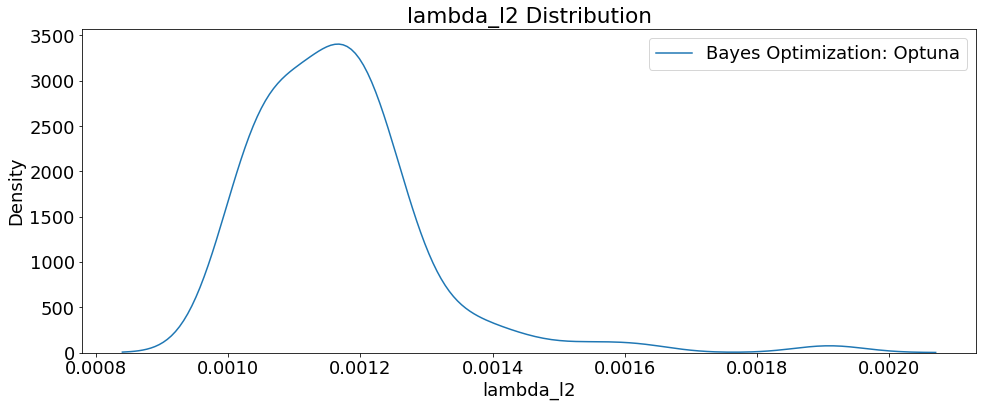

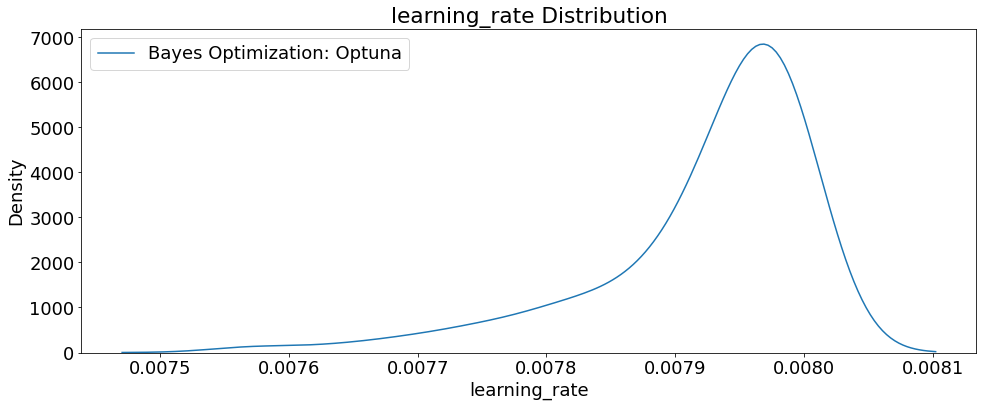

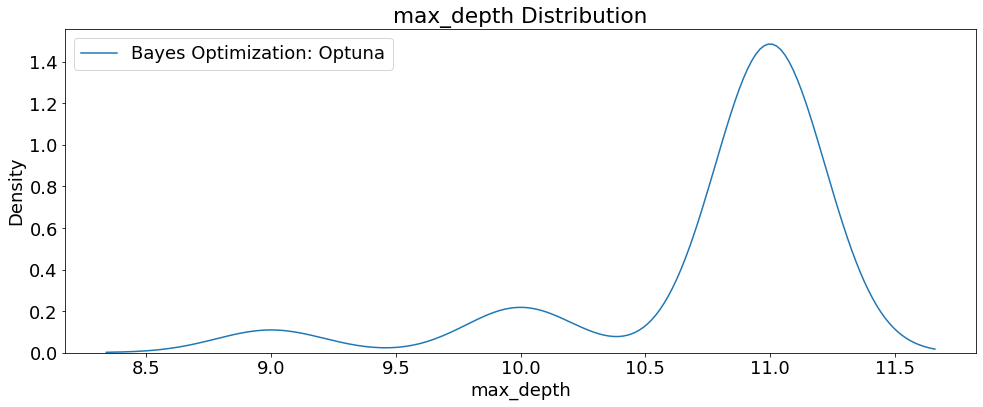

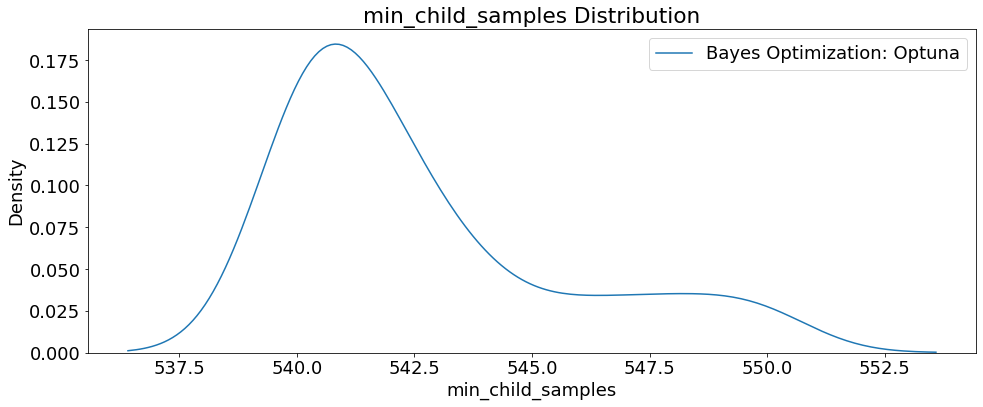

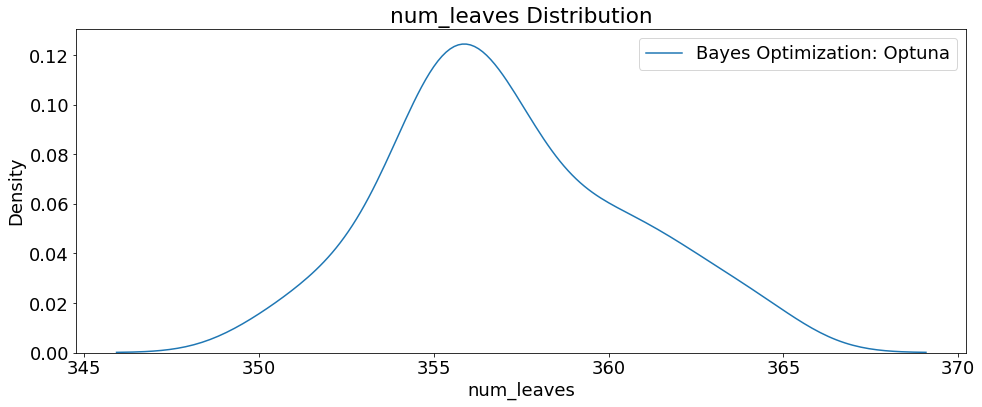

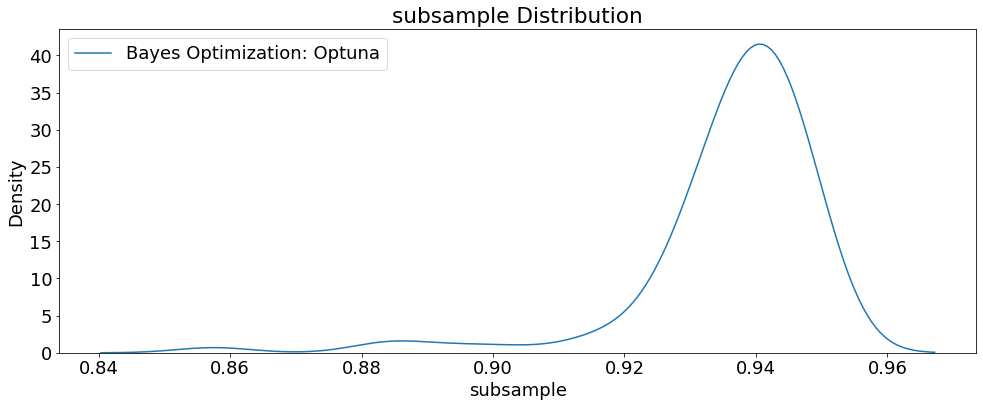

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

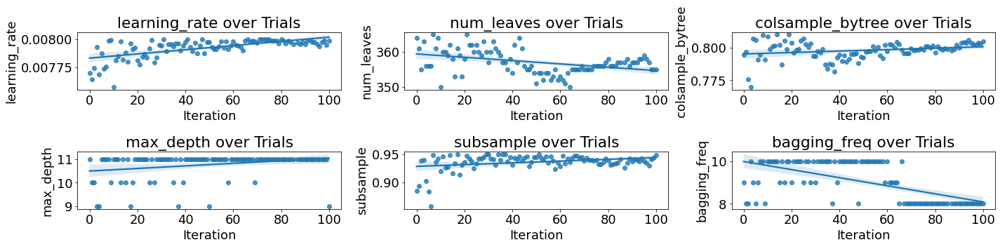

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

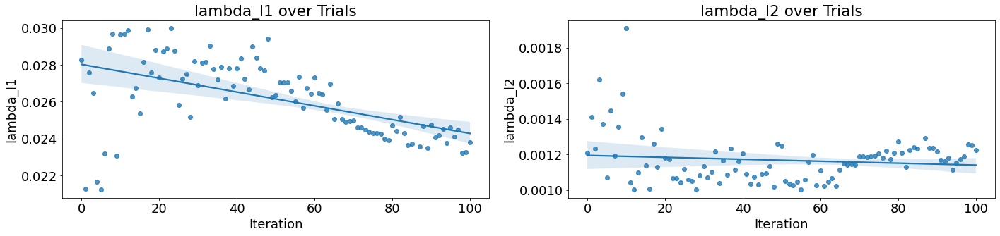

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_A4000_wb_trainValTest.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 935,
 'learning_rate': 0.007984853295875446,
 'num_leaves': 355,
 'bagging_freq': 8,
 'subsample': 0.9438207911781291,
 'colsample_bytree': 0.7956219126001296,
 'max_depth': 11,
 'lambda_l1': 0.02492318962109757,
 'lambda_l2': 0.0011435365417320647,
 'min_child_samples': 542,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials1000_GPU_A4000_wb_trainValTest.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials1000_GPU_A4000_wb_trainValTest.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.382, test: 1969.450
MSE train: 6812100.305, test: 6973105.999
RMSE train: 2610.000, test: 2640.664
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6973105.99910 MSE on the test set.
This was achieved using these conditions:
iteration                                    68
rmse                                2665.991746
datetime_start       2023-01-19 17:27:40.430412
datetime_complete    2023-01-19 17:31:45.926620
duration                 0 days 00:04:05.496208
bagging_freq                                8.0
colsample_bytree                       0.795622
lambda_l1                              0.024923
lambda_l2                              0.001144
learning_rate                          0.007985
max_depth                                  11.0
min_child_samples                         542.0
n_estimators                              935.0
num_leaves                                355.0
subsample                              0.943821
state                                  COMPLETE
Name: 68, dtype: object


# Quadro P5000

In [ ]:
# Install/import dependencies
import os
import random
import numpy as np  
import warnings
import pandas as pd
from sklearn.model_selection import cross_val_score, KFold
import joblib
import lightgbm as lgb
from lightgbm import LGBMRegressor
import optuna
from optuna import Trial
import wandb
from optuna.integration.wandb import WeightsAndBiasesCallback
optuna.logging.set_verbosity(optuna.logging.WARNING) 
from datetime import datetime, timedelta
from timeit import default_timer as timer
import pickle
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import plotly.offline as py
import matplotlib.pyplot as plt
import seaborn as sns
import eli5 
from eli5.sklearn import PermutationImportance 
import webbrowser
from eli5.formatters import format_as_dataframe
import shap
warnings.filterwarnings('ignore')
my_dpi = 96
os.environ['CUDA_VISIBLE_DEVICES'] = '0'

# Set seed 
seed_value = 42
os.environ['UsedCarsCarGurus_lgbmGPU'] = str(seed_value)
random.seed(seed_value)
np.random.seed(seed_value)

print('\n')
!nvcc --version
!nvidia-smi



nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Feb_14_21:12:58_PST_2021
Cuda compilation tools, release 11.2, V11.2.152
Build cuda_11.2.r11.2/compiler.29618528_0
Fri Feb  3 17:16:36 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.73.05    Driver Version: 510.73.05    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro P5000        Off  | 00000000:00:05.0 Off |                  Off |
| 26%   41C    P8     9W / 180W |      2MiB / 16384MiB |      0%      Default |
|                               |    

### 100 Trials 5-Fold Cross Validation 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Set up wandb
wandb.login()

wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_QuadroP5000_cv_nfold5', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_QuadroP5000_cv_nfold5'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Create a lgb dataset 
    train_set = lgb.Dataset(train_features, label=train_label, params=params)

    # Start timer for each trial
    start = timer()
      
    # Train the model
    # Perform k_folds cross validation to find lower error
    cv_results = lgb.cv(params, train_set, nfold=5, stratified=False)
    run_time = timer() - start

    # Extract best score
    rmse = round(cv_results['valid rmse-mean'][-1], 4)
    print('- Trial RMSE:', rmse)  
    
    return rmse

In [ ]:
# Load study to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 3
Best trial: {'n_estimators': 934, 'learning_rate': 0.007957417097096353, 'num_leaves': 361, 'bagging_freq': 9, 'subsample': 0.9032047249646911, 'colsample_bytree': 0.7984244668696676, 'max_depth': 11, 'lambda_l1': 0.025790877150311753, 'lambda_l2': 0.0010372579472183506, 'min_child_samples': 541}
Lowest RMSE 2690.0027


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=98, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

Start Time           2023-01-19 03:05:21.897435


- Trial RMSE: 2748.6525


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2745.5615


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2696.8976


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2694.4116


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2728.5219


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2719.0127


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2696.2907


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2721.3678


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2697.9916


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6305


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.332


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6665


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2714.4917


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2690.082


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2713.5344


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.1829


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2713.9638


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2696.001


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.1504


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.185


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.664


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2693.087


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.5345


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.4468


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2691.1882


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2713.4339


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2691.3966


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2744.5632


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2691.1963


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.6956


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.6112


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.0057


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.6183


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.4718


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.8102


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.8699


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2713.0762


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2744.9671


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.1008


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.4262


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.1867


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.5714


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.049


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.5827


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2689.0338


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2691.5982


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.0211


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2707.3467


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.2094


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.3606


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.159


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.4593


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


In [ ]:
# Load study to continue training
study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)

Number of finished trials: 56
Best trial: {'n_estimators': 929, 'learning_rate': 0.007877394919433501, 'num_leaves': 363, 'bagging_freq': 8, 'subsample': 0.9499672897041793, 'colsample_bytree': 0.7910413246689988, 'max_depth': 11, 'lambda_l1': 0.022357604328419593, 'lambda_l2': 0.00105430831250583, 'min_child_samples': 542}
Lowest RMSE 2686.0057


In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_5CV.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=45, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-01-19 07:09:45.420534


- Trial RMSE: 2686.3618


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8765


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.1036


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3599


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.4553


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2709.5351


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.5448


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.1065


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.4951


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.0187


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8125


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2221


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.6376


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.4374


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.6033


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2688.3084


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2741.6658


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.8321


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.2659


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8263


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.9341


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.8367


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.5142


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.1465


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8979


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2710.8516


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.8854


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.6512


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.6707


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8069


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.1887


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2687.7902


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.4809


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.6882


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.7019


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.7363


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2686.3578


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.8274


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3552


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2684.3347


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.0426


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.3583


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.106


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.5396


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


- Trial RMSE: 2685.955


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-01-19 07:09:45.420534
End Time             2023-01-19 11:52:30.014380
4:42:44


Number of finished trials: 101
Best trial: {'n_estimators': 928, 'learning_rate': 0.00799995793205517, 'num_leaves': 362, 'bagging_freq': 9, 'subsample': 0.9480243348736116, 'colsample_bytree': 0.8057484065817484, 'max_depth': 11, 'lambda_l1': 0.021403931872852878, 'lambda_l2': 0.0012964100075579395, 'min_child_samples': 543}
Lowest RMSE 2684.3347


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_P5000_wb_CV.csv', index=False)
print(trials_df) 

    iteration       rmse             datetime_start  \
95         95  2684.3347 2023-01-19 11:07:45.552046   
57         57  2684.8765 2023-01-19 07:14:59.176996   
82         82  2684.8854 2023-01-19 09:41:16.364908   
65         65  2685.0187 2023-01-19 07:58:34.456985   
96         96  2685.0426 2023-01-19 11:16:10.640717   
..        ...        ...                        ...   
4           4  2745.5615 2023-01-19 03:08:22.436582   
0           0  2745.6842 2023-01-19 01:57:55.423304   
3           3  2748.6525 2023-01-19 03:05:21.901863   
2           2        NaN 2023-01-19 02:05:31.868063   
55         55        NaN 2023-01-19 06:18:47.071440   

            datetime_complete               duration  bagging_freq  \
95 2023-01-19 11:16:04.318300 0 days 00:08:18.766254           9.0   
57 2023-01-19 07:19:43.421274 0 days 00:04:44.244278           9.0   
82 2023-01-19 09:47:19.044842 0 days 00:06:02.679934           9.0   
65 2023-01-19 08:04:02.764893 0 days 00:05:28.307908       

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


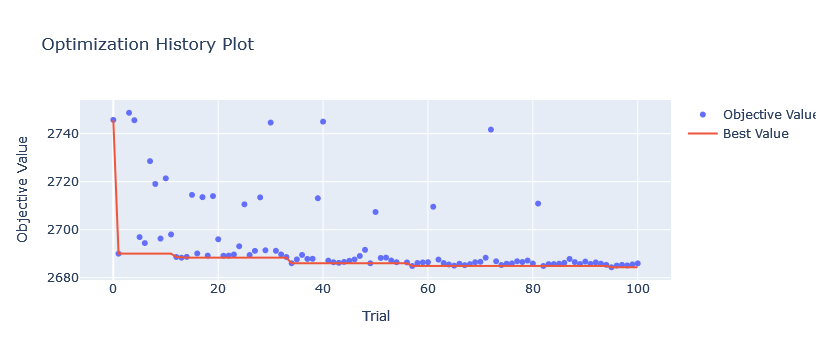

In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_P5000_wb_CV.html')
fig.show()

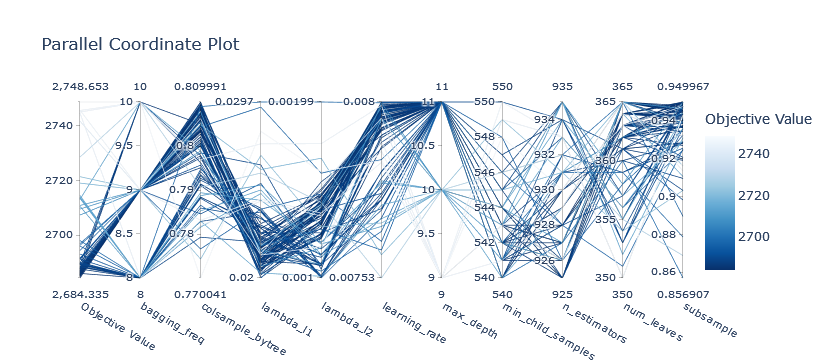

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_P5000_wb_CV.html')
fig.show()

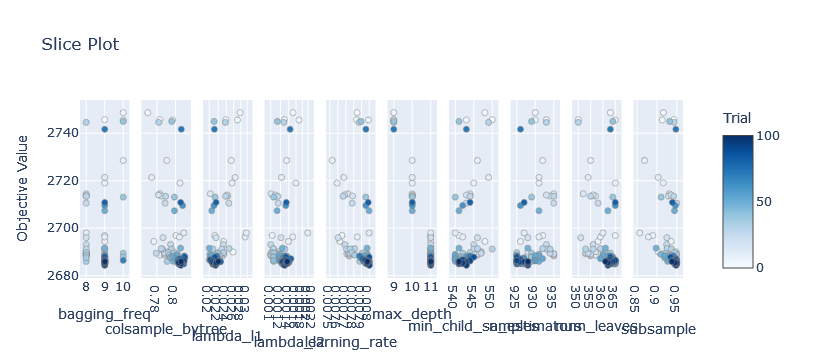

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_P5000_wb_CV.html')
fig.show()

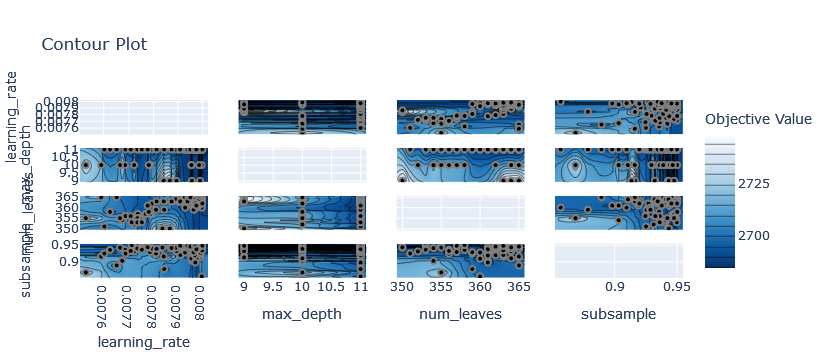

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_P5000_wb_CV.html')
fig.show()

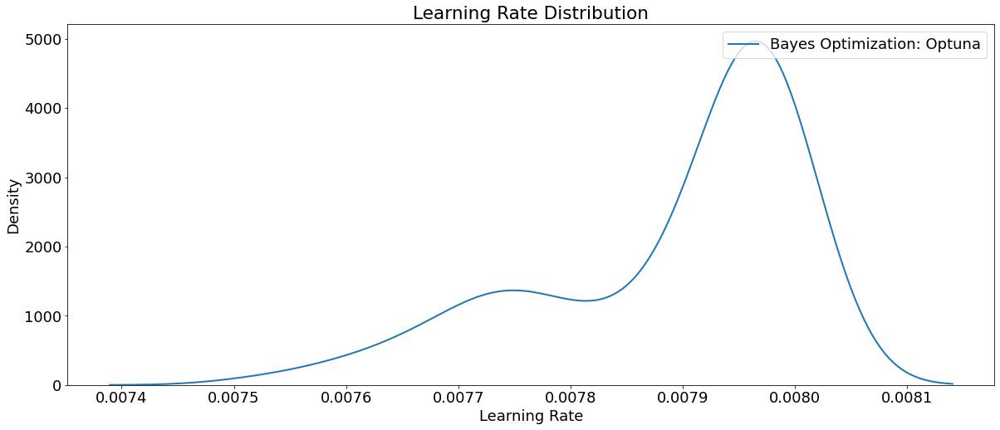

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

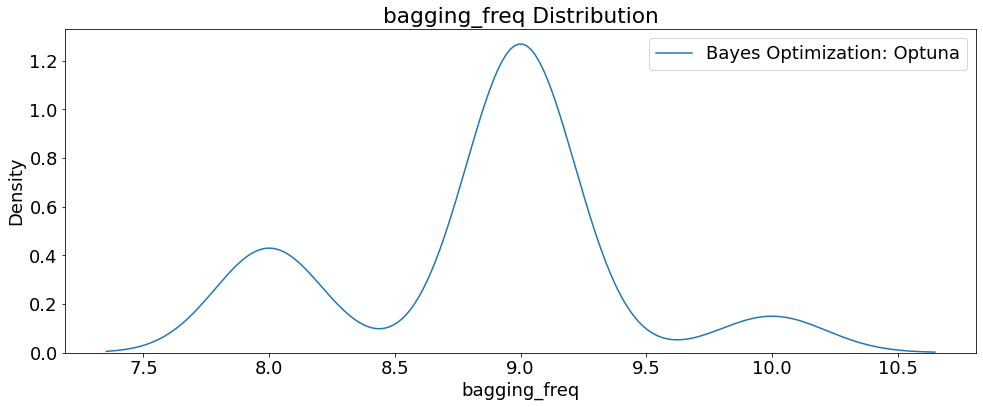

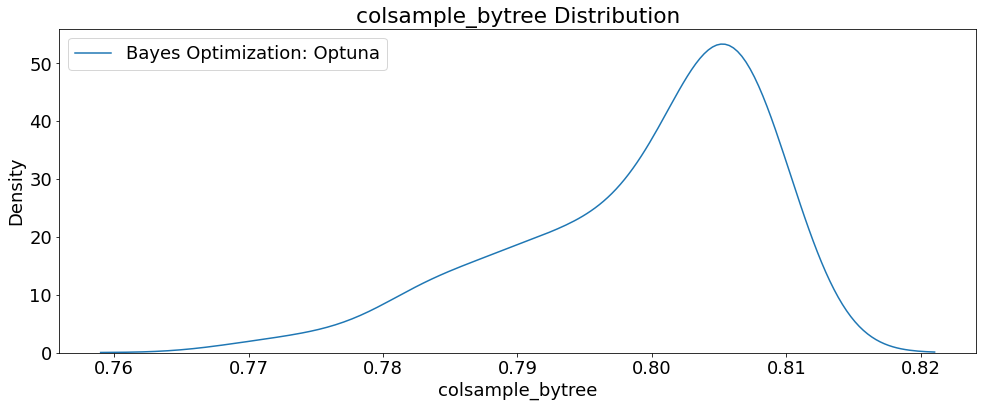

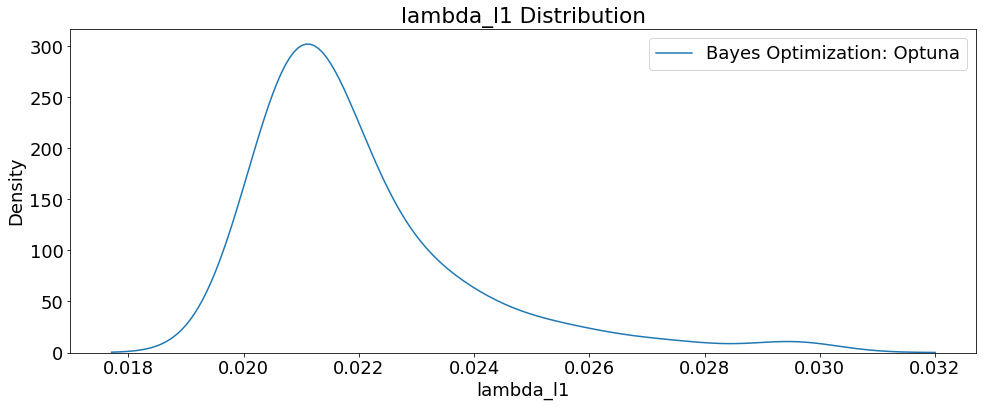

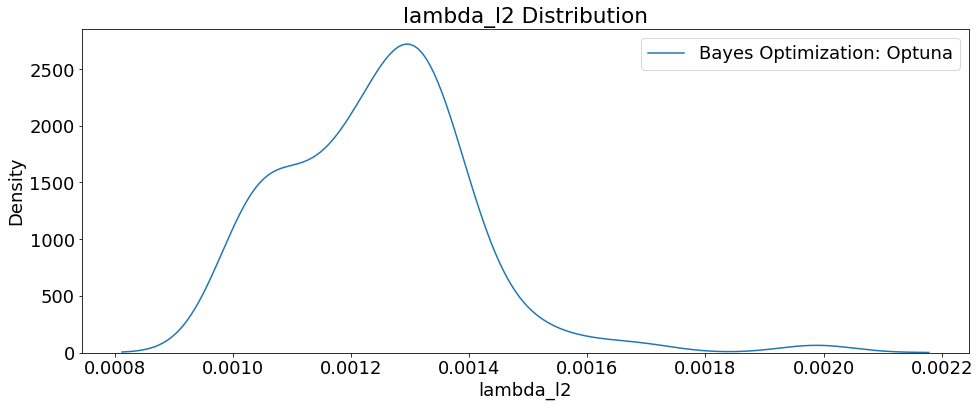

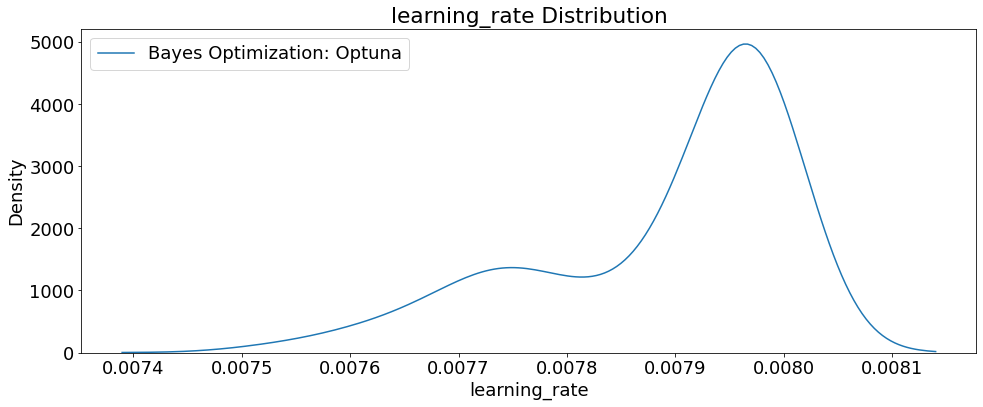

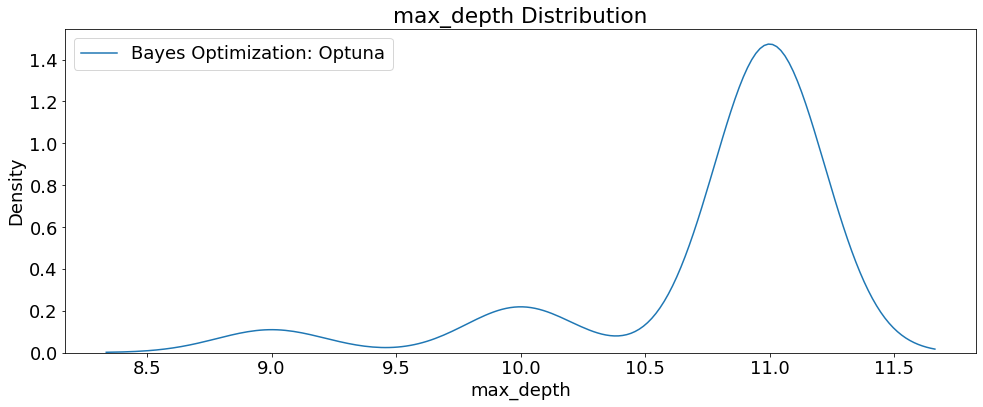

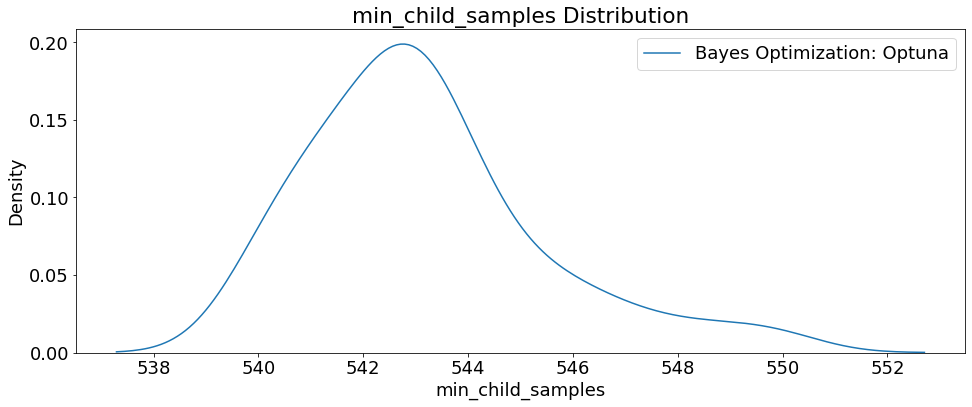

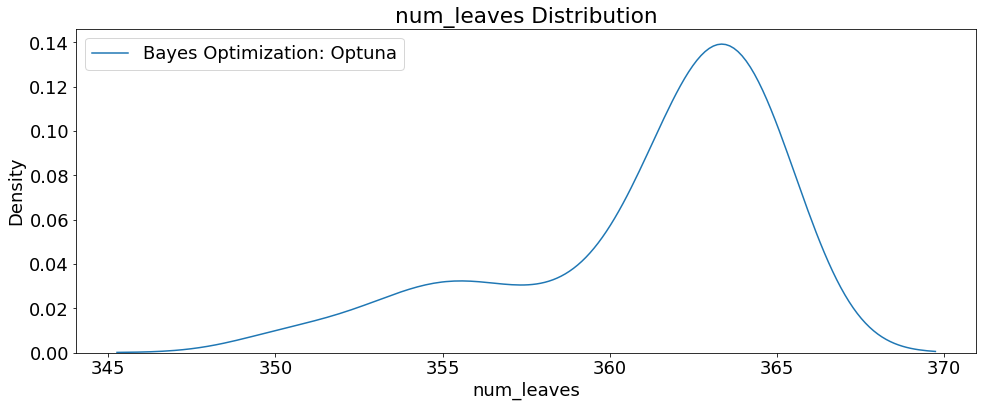

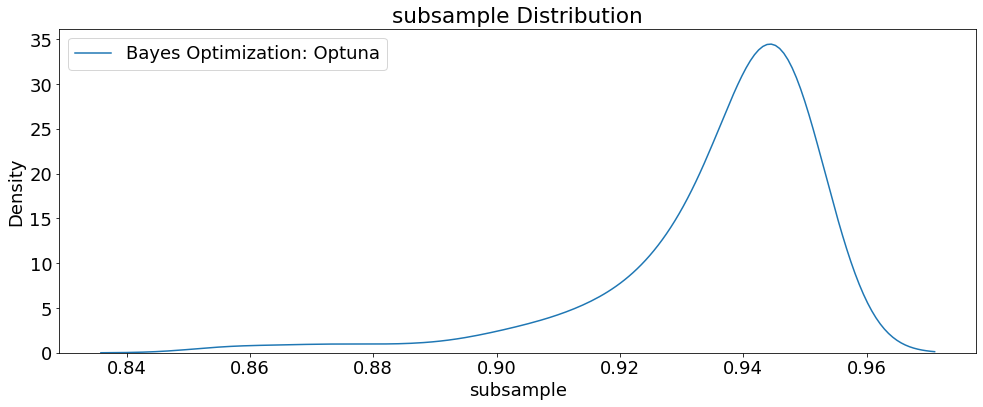

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

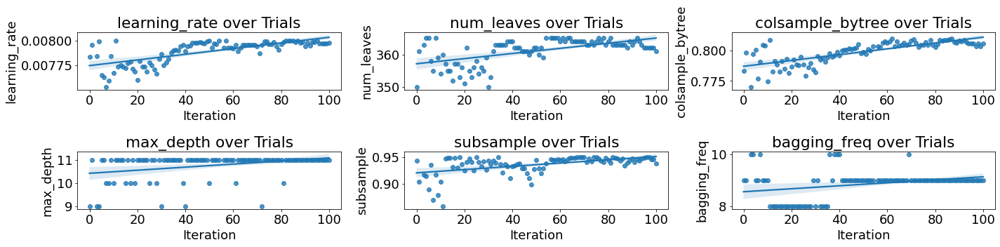

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

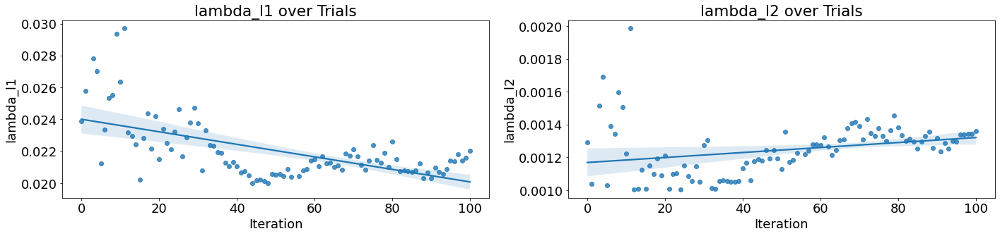

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

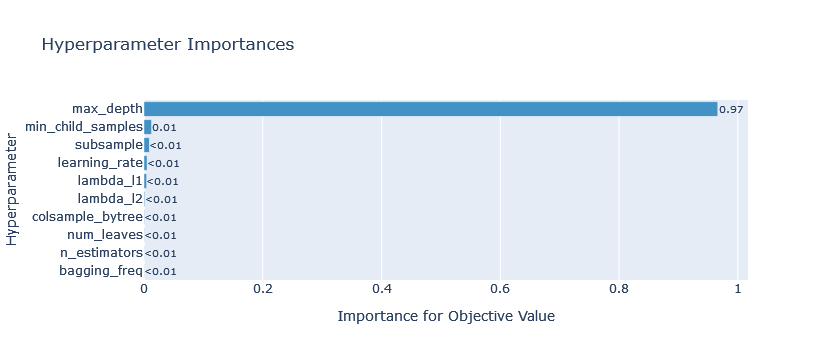

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_P5000_wb_CV.html')
fig.show()

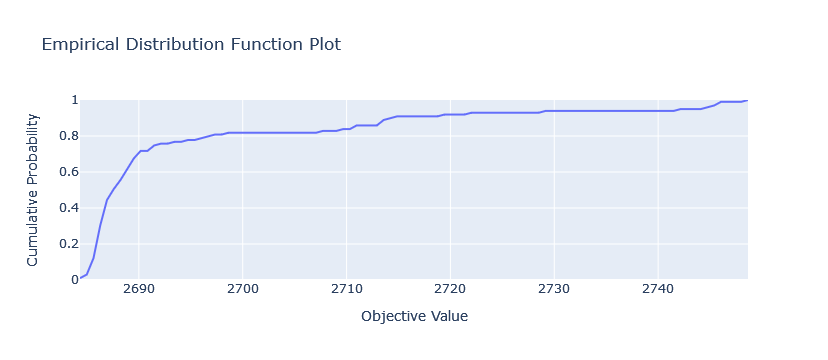

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_P5000_wb_CV.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params

{'n_estimators': 928,
 'learning_rate': 0.00799995793205517,
 'num_leaves': 362,
 'bagging_freq': 9,
 'subsample': 0.9480243348736116,
 'colsample_bytree': 0.8057484065817484,
 'max_depth': 11,
 'lambda_l1': 0.021403931872852878,
 'lambda_l2': 0.0012964100075579395,
 'min_child_samples': 543,
 'random_state': 42,
 'metric': 'rmse'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials100_GPU_P5000_wb_CV.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials100_GPU_P5000_wb_CV.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1945.618, test: 1968.829
MSE train: 6816116.455, test: 6975530.201
RMSE train: 2610.769, test: 2641.123
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6975530.20056 MSE on the test set.
This was achieved using these conditions:
iteration                                    95
rmse                                  2684.3347
datetime_start       2023-01-19 11:07:45.552046
datetime_complete    2023-01-19 11:16:04.318300
duration                 0 days 00:08:18.766254
bagging_freq                                9.0
colsample_bytree                       0.805748
lambda_l1                              0.021404
lambda_l2                              0.001296
learning_rate                             0.008
max_depth                                  11.0
min_child_samples                         543.0
n_estimators                              928.0
num_leaves                                362.0
subsample                              0.948024
state                                  COMPLETE
Name: 95, dtype: object


## 100 Trials Train/Validation/Test 

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Log in wandb
wandb.login()

# Set up wandb
wandb_kwargs = {'project': 'usedCars_hpo', 'entity': 'aschultz', 
                'group': 'optuna_lgbm100gpu_P5000_trainValTest_kfold10', 
                'save_code': 'False', 
                'notes': 'optuna_lgbm100gpu_P5000_trainValTest_kfold10'}
wandbc = WeightsAndBiasesCallback(wandb_kwargs=wandb_kwargs, as_multirun=True)

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
# Set up WB callbacks
@wandbc.track_in_wandb()

# Define a function for optimization of hyperparameters
def objective(trial):
    
    joblib.dump(study, 'lightGBM_Optuna_100_GPU_P5000_wb_trainValSplit.pkl')

    params = {'verbose': -1, 
              'boosting_type': 'gbdt',
              'objective':'regression',
              'metric': 'rmse', 
              'seed': seed_value,
              'early_stopping_rounds': 150,
              'n_estimators': trial.suggest_int('n_estimators', 925, 935),
              'learning_rate': trial.suggest_loguniform('learning_rate', 
                                                        0.0075, 0.008),
              'num_leaves': trial.suggest_int('num_leaves', 350, 365),
              'bagging_freq': trial.suggest_int('bagging_freq', 8, 10),
              'subsample': trial.suggest_float('subsample', 0.85, 0.95),
              'colsample_bytree': trial.suggest_float('colsample_bytree', 
                                                      0.77, 0.81),
              'max_depth': trial.suggest_int('max_depth', 9, 11),
              'lambda_l1': trial.suggest_float('lambda_l1', 0.02, 0.03, 
                                               log=True),
              'lambda_l2': trial.suggest_float('lambda_l2', 0.001, 0.002,  
                                               log=True),
              'min_child_samples': trial.suggest_int('min_child_samples', 
                                                     540, 550),
              'device': 'gpu',
              'gpu_platform_id': 0,
              'gpu_device_id': 0}
    
    # Set same k-folds for reproducibility
    kf = KFold(n_splits=10, shuffle=True, random_state=seed_value)

    # Create train and validation sets
    for trn_idx, val_idx in kf.split(trainDF[features], train_label): 
        train_Features, train_Label = trainDF[features].iloc[trn_idx], train_label.iloc[trn_idx]
        val_Features, val_Label = trainDF[features].iloc[val_idx], train_label.iloc[val_idx] 

      # Define model
      model = LGBMRegressor(**params)

      # Start timer for each trial
      start = timer()
      
      # Train the model
      model.fit(train_Features, train_Label, 
                eval_set = [(val_Features, val_Label), 
                            (train_Features, train_Label)]) 
      run_time = timer() - start

      # Predictions
      y_pred_val = model.predict(val_Features)
      rmse = mean_squared_error(val_Label, y_pred_val, squared=False)
      
    return rmse

In [ ]:
# Begin HPO trials 
# Start timer for experiment
start_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
if os.path.isfile('lightGBM_Optuna_100_GPU_P5000_wb_trainValSplit.pkl'):
    study = joblib.load('lightGBM_Optuna_100_GPU_P5000_wb_trainValSplit.pkl')
else:
    study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100, callbacks=[wandbc])

# End timer for experiment
end_time = datetime.now()
print('%-20s %s' % ('Start Time', start_time))
print('%-20s %s' % ('End Time', end_time))
print(str(timedelta(seconds=(end_time-start_time).seconds)))
print('\n')
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)
print('Lowest RMSE', study.best_value)
wandb.finish()

wandb: Currently logged in as: aschultz. Use `wandb login --relogin` to force relogin


Start Time           2023-02-03 17:50:45.777237


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


bagging_freq,▁
colsample_bytree,▁
lambda_l1,▁
lambda_l2,▁
learning_rate,▁
max_depth,▁
min_child_samples,▁
n_estimators,▁
num_leaves,▁
subsample,▁
trial_number,▁


Start Time           2023-02-03 17:50:45.777237
End Time             2023-02-03 18:58:11.853041
1:07:26


Number of finished trials: 100
Best trial: {'n_estimators': 933, 'learning_rate': 0.00797492964893136, 'num_leaves': 365, 'bagging_freq': 9, 'subsample': 0.9443692578147552, 'colsample_bytree': 0.7754165328931638, 'max_depth': 11, 'lambda_l1': 0.029291406954033285, 'lambda_l2': 0.0017055679121518938, 'min_child_samples': 540}
Lowest RMSE 2682.720515797153


In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/trialOptions


In [ ]:
# Output from HPO trials
trials_df = study.trials_dataframe()
trials_df.rename(columns={'number': 'iteration'}, inplace=True)
trials_df.rename(columns={'value': 'rmse'}, inplace=True)
trials_df.rename(columns={'params_bagging_freq': 'bagging_freq'}, inplace=True)
trials_df.rename(columns={'params_colsample_bytree': 'colsample_bytree'}, 
                 inplace=True)
trials_df.rename(columns={'params_lambda_l1': 'lambda_l1'}, inplace=True)
trials_df.rename(columns={'params_lambda_l2': 'lambda_l2'}, inplace=True)
trials_df.rename(columns={'params_learning_rate': 'learning_rate'}, 
                 inplace=True)
trials_df.rename(columns={'params_max_depth': 'max_depth'}, inplace=True)
trials_df.rename(columns={'params_min_child_samples': 'min_child_samples'}, 
                 inplace=True)
trials_df.rename(columns={'params_n_estimators': 'n_estimators'}, inplace=True)
trials_df.rename(columns={'params_num_leaves': 'num_leaves'}, inplace=True)
trials_df.rename(columns={'params_subsample': 'subsample'}, inplace=True)
trials_df = trials_df.sort_values('rmse', ascending=True)

# Write processed data to csv
trials_df.to_csv('lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.csv', 
                 index=False)
print(trials_df) 

    iteration         rmse             datetime_start  \
97         97  2682.720516 2023-02-03 18:56:14.214499   
99         99  2682.935050 2023-02-03 18:57:33.596386   
91         91  2683.543395 2023-02-03 18:52:20.926629   
81         81  2683.865529 2023-02-03 18:45:24.972047   
95         95  2684.031952 2023-02-03 18:54:57.440130   
..        ...          ...                        ...   
0           0  2745.102568 2023-02-03 17:50:45.778901   
60         60  2746.787934 2023-02-03 18:31:00.277820   
4           4  2752.398283 2023-02-03 17:53:26.297062   
8           8  2756.845184 2023-02-03 17:56:02.054981   
6           6  2757.382306 2023-02-03 17:54:41.100660   

            datetime_complete               duration  bagging_freq  \
97 2023-02-03 18:56:50.938330 0 days 00:00:36.723831             9   
99 2023-02-03 18:58:08.586189 0 days 00:00:34.989803             9   
91 2023-02-03 18:52:55.384525 0 days 00:00:34.457896             9   
81 2023-02-03 18:46:07.929932 0 day

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_Explanations


In [ ]:
# Plot_optimization_history: shows the scores from all trials as well as the best score so far at each point.
fig = optuna.visualization.plot_optimization_history(study)
py.plot(fig, filename='optimizationHistory_lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_parallel_coordinate: interactively visualizes the hyperparameters and scores
fig = optuna.visualization.plot_parallel_coordinate(study)
py.plot(fig, filename='parallelCoordinate_lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_slice: shows the change of the hyperparameters space over the search. 
fig = optuna.visualization.plot_slice(study)
py.plot(fig, filename='slice_lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.html')
fig.show()

In [ ]:
# plot_contour: plots parameter interactions on an interactive chart
fig = optuna.visualization.plot_contour(study, params=['num_leaves', 
                                                       'max_depth', 
                                                       'subsample', 
                                                       'learning_rate', 
                                                       'subsample'])
py.plot(fig, filename='contour_lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.html')
fig.show()

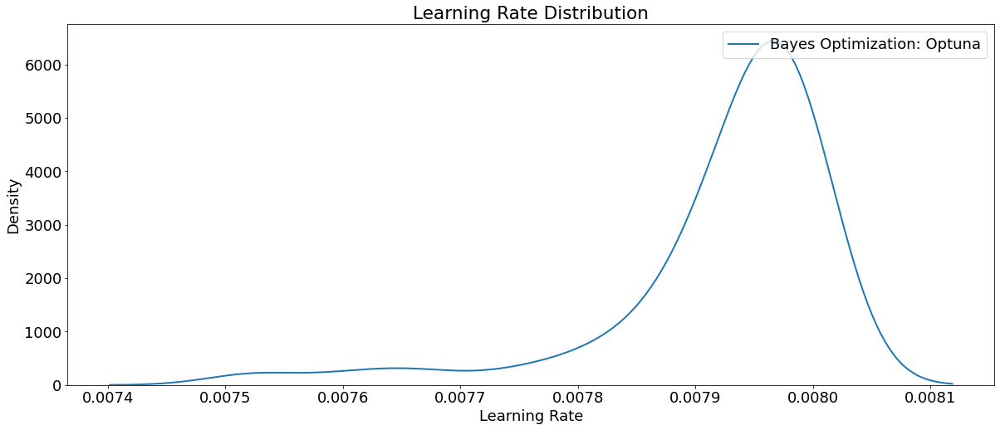

In [ ]:
# Density plots of the learning rate distributions 
plt.figure(figsize=(20,8))
plt.rcParams['font.size'] = 18
sns.kdeplot(trials_df['learning_rate'], label='Bayes Optimization: Optuna', 
            linewidth=2)
plt.legend(loc=1)
plt.xlabel('Learning Rate'); plt.ylabel('Density'); 
plt.title('Learning Rate Distribution');
plt.show()

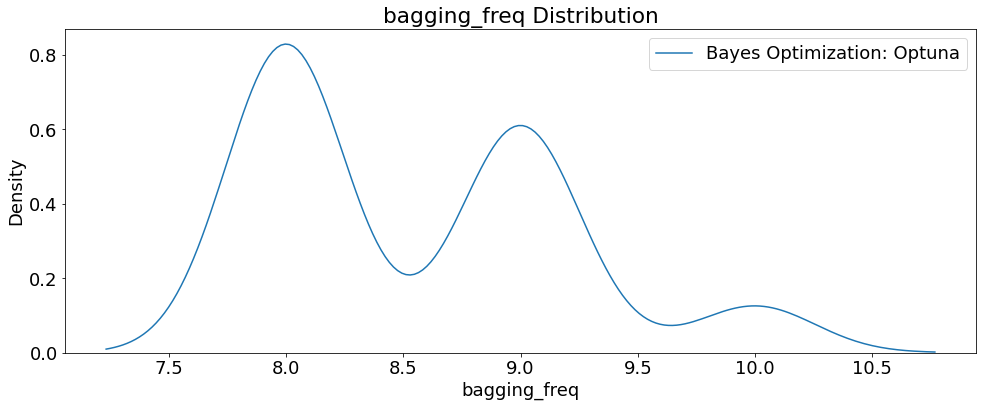

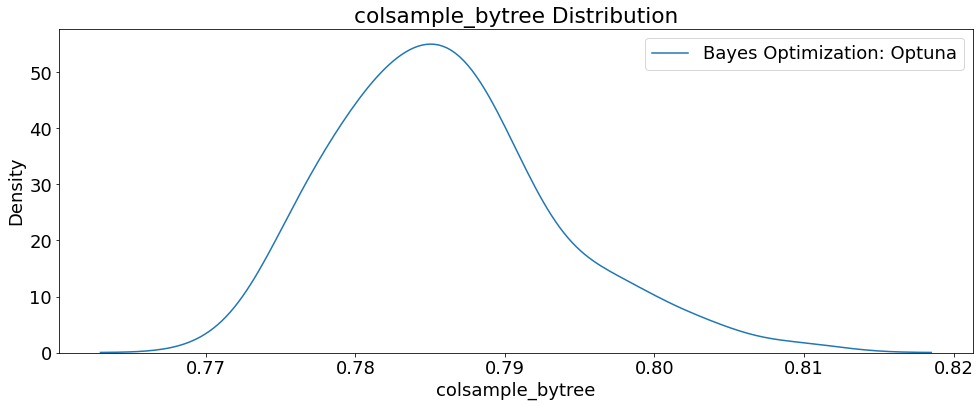

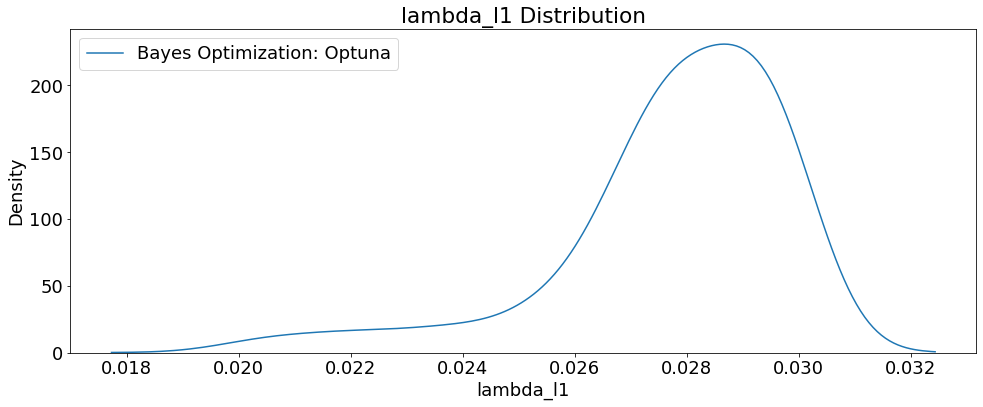

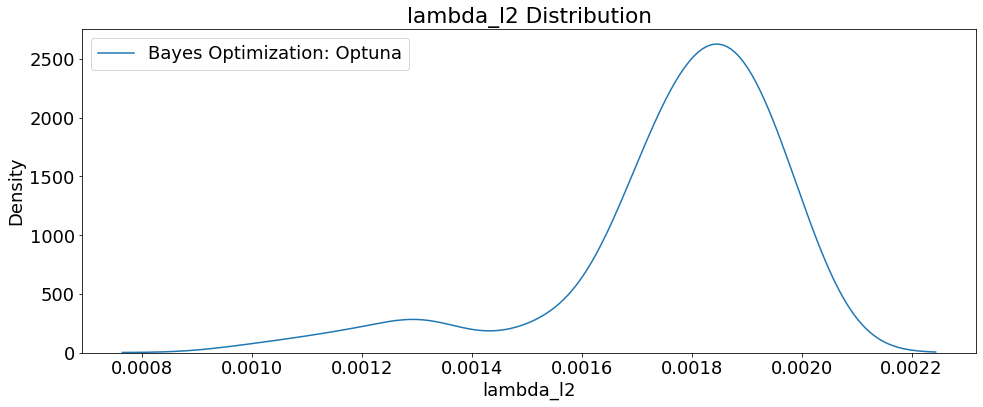

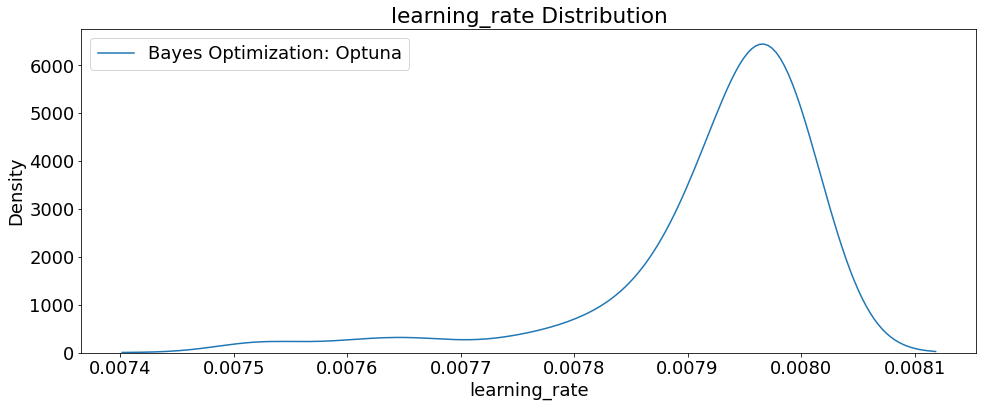

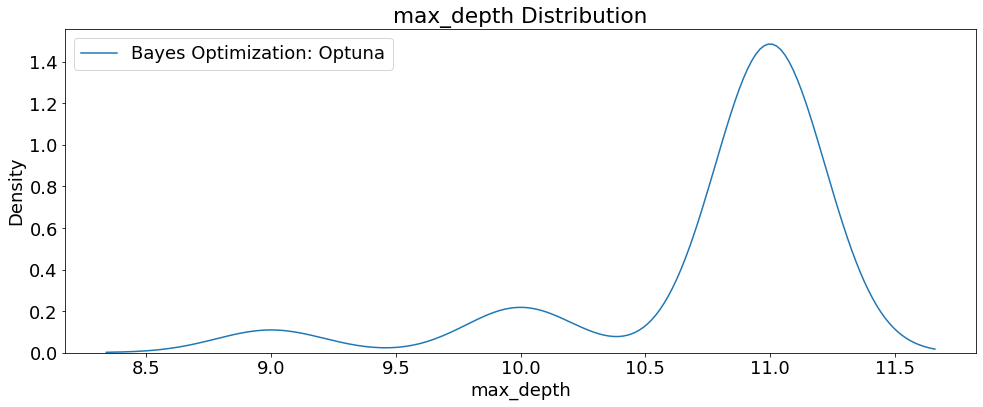

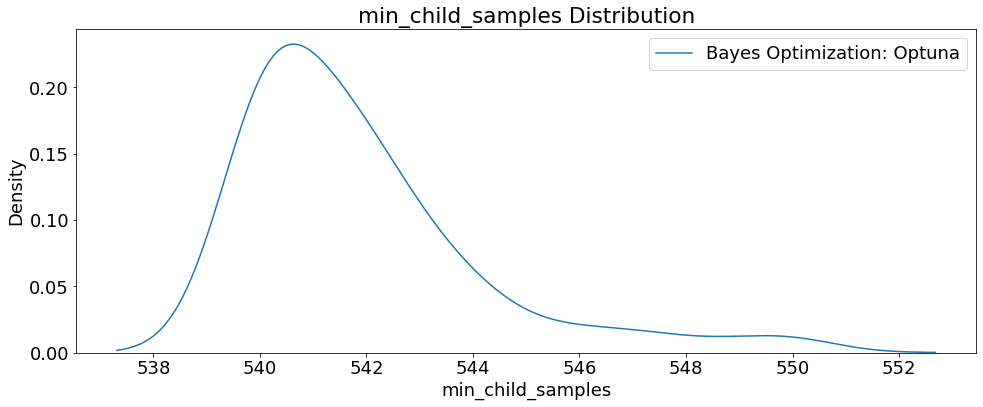

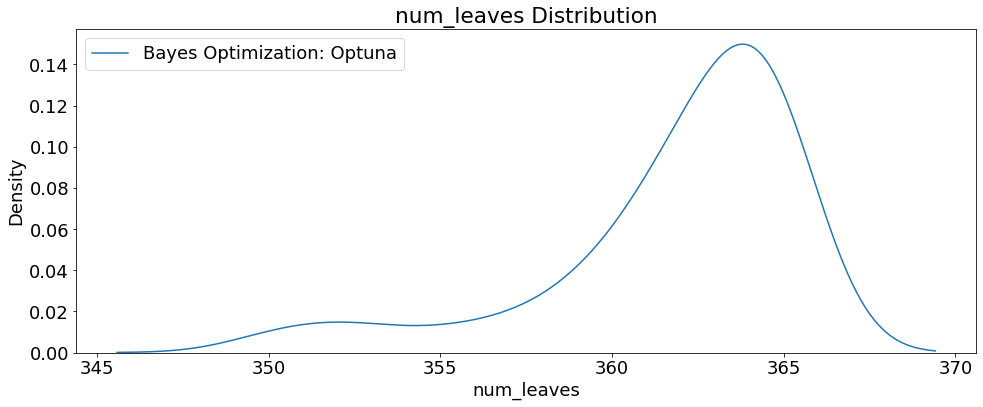

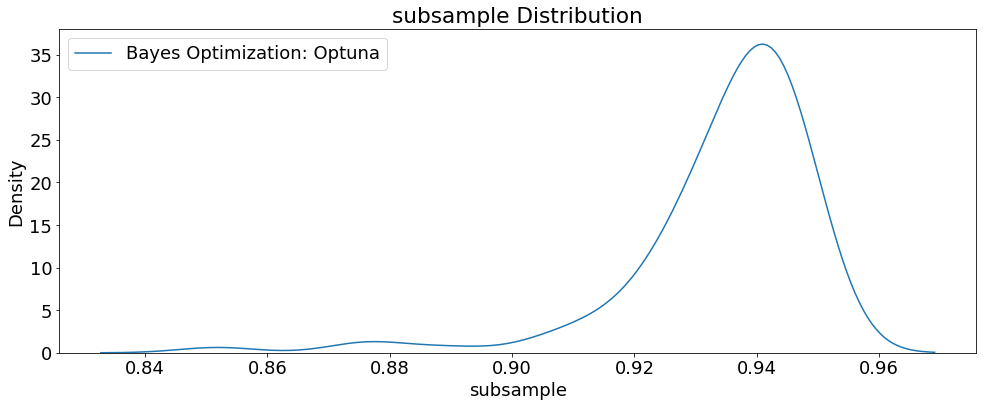

In [ ]:
# Create plots of Hyperparameters that are numeric 
for i, hpo in enumerate(trials_df.columns):
    if hpo not in ['iteration', 'rmse', 'datetime_start', 'datetime_complete',
                   'duration', 'n_estimators', 'state']:
        plt.figure(figsize=(14,6))
        # Plot the bayes search distribution
        if hpo != 'loss':
            sns.kdeplot(trials_df[hpo], label='Bayes Optimization: Optuna')
            plt.legend(loc=0)
            plt.title('{} Distribution'.format(hpo))
            plt.xlabel('{}'.format(hpo)); plt.ylabel('Density')
            plt.tight_layout()
            plt.show()

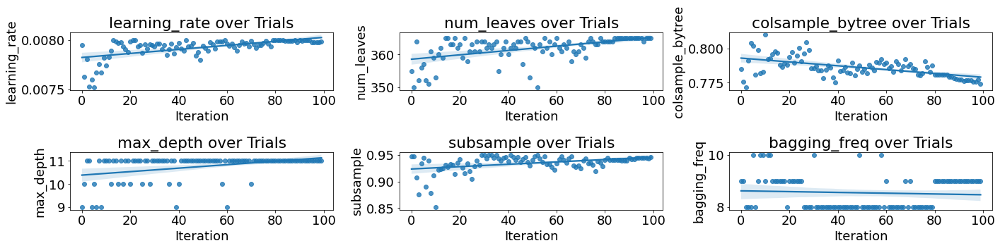

In [ ]:
# Plot quantitive hyperparameters
fig, axs = plt.subplots(2, 3, figsize=(20,5))
i = 0
axs = axs.flatten()
for i, hpo in enumerate(['learning_rate', 'num_leaves', 'colsample_bytree', 
                         'max_depth', 'subsample', 'bagging_freq']):
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i]) 
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo),  
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

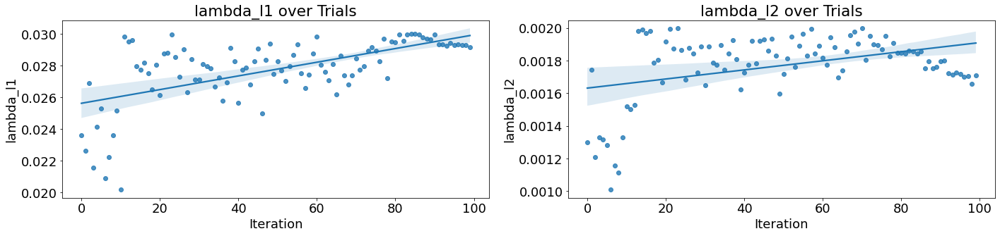

In [ ]:
# Scatterplot of regularization hyperparameters)
fig, axs = plt.subplots(1, 2, figsize=(20,5))
i = 0
for i, hpo in enumerate(['lambda_l1', 'lambda_l2']): 
    # Scatterplot
    sns.regplot('iteration', hpo, data=trials_df, ax=axs[i])
    axs[i].set(xlabel='Iteration', ylabel='{}'.format(hpo), 
               title='{} over Trials'.format(hpo))
plt.tight_layout()
plt.show()

In [ ]:
# Visualize parameter importances
fig = optuna.visualization.plot_param_importances(study)
py.plot(fig, filename='paramImportance_lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.html')
fig.show()

In [ ]:
# Visualize empirical distribution function
fig = optuna.visualization.plot_edf(study)
py.plot(fig, filename='edf_lightGBM_Optuna_100_GPU_P5000_wb_trainValTest.html')
fig.show()

In [ ]:
# Arrange best parameters to fit model for model metrics
params = study.best_params   
params['random_state'] = seed_value
params['metric'] = 'rmse'
params['device'] = 'gpu',
params['gpu_platform_id'] = 0
params['gpu_device_id'] = 0
params['boosting_type'] = 'gbdt'
params['objective'] ='regression'
params

{'n_estimators': 933,
 'learning_rate': 0.00797492964893136,
 'num_leaves': 365,
 'bagging_freq': 9,
 'subsample': 0.9443692578147552,
 'colsample_bytree': 0.7754165328931638,
 'max_depth': 11,
 'lambda_l1': 0.029291406954033285,
 'lambda_l2': 0.0017055679121518938,
 'min_child_samples': 540,
 'random_state': 42,
 'metric': 'rmse',
 'device': ('gpu',),
 'gpu_platform_id': 0,
 'gpu_device_id': 0,
 'boosting_type': 'gbdt',
 'objective': 'regression'}

In [ ]:
# Write results to ML Results
%cd /notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL/

/notebooks/UsedCarsCarGurus/Models/ML/LightGBM/Optuna/Model_PKL


In [ ]:
# Re-create the best model and train on the training data
best_model = LGBMRegressor(**params, verbosity=-1)

# Fit the model
best_model.fit(train_features, train_label)

# Save model
Pkl_Filename = 'lightGBM_Optuna_trials1000_GPU_P5000_wb_trainValTest.pkl'  

with open(Pkl_Filename, 'wb') as file:  
    pickle.dump(best_model, file)

# =============================================================================
# # To load saved model
# model = joblib.load('lightGBM_Optuna_trials1000_GPU_P5000_wb_trainValTest.pkl')
# print(model)
# =============================================================================

print('\nModel Metrics for lightGBM HPO 100 GPU trials')
y_train_pred = best_model.predict(train_features)
y_test_pred = best_model.predict(test_features)

print('MAE train: %.3f, test: %.3f' % (
        mean_absolute_error(train_label, y_train_pred),
        mean_absolute_error(test_label, y_test_pred)))
print('MSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred),
        mean_squared_error(test_label, y_test_pred)))
print('RMSE train: %.3f, test: %.3f' % (
        mean_squared_error(train_label, y_train_pred, squared=False),
        mean_squared_error(test_label, y_test_pred, squared=False)))
print('R^2 train: %.3f, test: %.3f' % (
        r2_score(train_label, y_train_pred),
        r2_score(test_label, y_test_pred)))


Model Metrics for lightGBM HPO 100 GPU trials
MAE train: 1946.194, test: 1969.331
MSE train: 6819990.493, test: 6978334.891
RMSE train: 2611.511, test: 2641.654
R^2 train: 0.926, test: 0.924


In [ ]:
# Evaluate on the testing data 
print('The best model from optimization scores {:.5f} MSE on the test set.'.format(mean_squared_error(test_label, 
                                                                                                      y_test_pred)))
print('This was achieved using these conditions:')
print(trials_df.iloc[0])

The best model from optimization scores 6978334.89147 MSE on the test set.
This was achieved using these conditions:
iteration                                    97
rmse                                2682.720516
datetime_start       2023-02-03 18:56:14.214499
datetime_complete    2023-02-03 18:56:50.938330
duration                 0 days 00:00:36.723831
bagging_freq                                  9
colsample_bytree                       0.775417
lambda_l1                              0.029291
lambda_l2                              0.001706
learning_rate                          0.007975
max_depth                                    11
min_child_samples                           540
n_estimators                                933
num_leaves                                  365
subsample                              0.944369
state                                  COMPLETE
Name: 97, dtype: object
